In [1]:
#install Alphafold python library

!wget -nc https://github.com/cisco/openh264/releases/download/v1.8.0/libopenh264-1.8.0-linux64.4.so.bz2
!bzip2 -d libopenh264-1.8.0-linux64.4.so.bz2

!apt update
!apt install -y ffmpeg

!pip install matplotlib
!pip3 install --upgrade ../.
!pip install -U scikit-learn
!pip3 install ffmpeg-python
!pip3 install opencv-python

File ‘libopenh264-1.8.0-linux64.4.so.bz2’ already there; not retrieving.

bzip2: Output file libopenh264-1.8.0-linux64.4.so already exists.
Get:1 http://security.ubuntu.com/ubuntu focal-security InRelease [114 kB]
Hit:2 http://archive.ubuntu.com/ubuntu focal InRelease                         
Ign:3 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2004/x86_64  InRelease
Hit:4 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2004/x86_64  Release
Get:5 http://archive.ubuntu.com/ubuntu focal-updates InRelease [114 kB]
Get:7 http://archive.ubuntu.com/ubuntu focal-backports InRelease [101 kB]
Get:8 http://archive.ubuntu.com/ubuntu focal-updates/main amd64 Packages [1419 kB]
Get:9 http://archive.ubuntu.com/ubuntu focal-updates/universe amd64 Packages [1055 kB]
Fetched 2802 kB in 2s (1756 kB/s)                     
Reading package lists... Done
Building dependency tree       
Reading state information... Done
50 packages can be upgraded. Run 'apt list --upgradable' 

  Created wheel for alphafold: filename=alphafold-2.0.0-py3-none-any.whl size=167358 sha256=9662c5cfa0b606f3e16d71fbd6eb69a7164c3fb0ed86a60dfa1f98e8865a7ba6
  Stored in directory: /tmp/pip-ephem-wheel-cache-jk9jmgrl/wheels/24/78/39/1d9adc7578a3110de260b58b488a10309326e694fcdf4c2b43
Successfully built alphafold
  Attempting uninstall: alphafold
    Found existing installation: alphafold 2.0.0
    Uninstalling alphafold-2.0.0:
      Successfully uninstalled alphafold-2.0.0


In [2]:
from IPython.utils import io
import os
import subprocess
import tqdm.notebook

import jax
import jax.numpy as jnp
import haiku as hk

import sys
sys.path.append('/opt/conda/lib/python3.7/site-packages')

import os
os.environ['TF_FORCE_UNIFIED_MEMORY'] = '1'
os.environ['XLA_PYTHON_CLIENT_MEM_FRACTION'] = '2.0'

from urllib import request
from concurrent import futures
import json
from matplotlib import gridspec
import matplotlib.pyplot as plt
import numpy as np
#import py3Dmol

import cv2
import math
import sklearn
from sklearn.decomposition import PCA

from alphafold.model import model
from alphafold.model import config
from alphafold.model import data

from alphafold.data import parsers
from alphafold.data import pipeline
from alphafold.data.tools import jackhmmer

from alphafold.common import protein

from alphafold.relax import relax
from alphafold.relax import utils

from IPython import display
from ipywidgets import GridspecLayout
from ipywidgets import Output

In [3]:
model_names = ['model_1', 'model_2', 'model_3', 'model_4', 'model_5', 'model_2_ptm']

def _placeholder_template_feats(num_templates_, num_res_):
    return {
        'template_aatype': np.zeros([num_templates_, num_res_, 22], np.float32),
        'template_all_atom_masks': np.zeros([num_templates_, num_res_, 37, 3], np.float32),
        'template_all_atom_positions': np.zeros([num_templates_, num_res_, 37], np.float32),
        'template_domain_names': np.zeros([num_templates_], np.float32),
        'template_sum_probs': np.zeros([num_templates_], np.float32),
    }

In [4]:
model_name = 'model_2'

cfg = config.model_config(model_name)
params = data.get_model_haiku_params(model_name, '../alphafold/data')
model_runner = model.RunModel(cfg, params)

In [16]:
def unroll_dict_keys(d, parent_keys=""):
    if type(d) is not dict:
        return [parent_keys + " " + str(d.shape)]
    names = []
    for key in d.keys():
        names.extend(unroll_dict_keys(d[key], parent_keys=parent_keys+' '+key))
    
    return names

unroll_dict_keys(params)

[' alphafold/alphafold_iteration/evoformer/preprocess_1d weights (22, 256)',
 ' alphafold/alphafold_iteration/evoformer/preprocess_1d bias (256,)',
 ' alphafold/alphafold_iteration/evoformer/preprocess_msa weights (49, 256)',
 ' alphafold/alphafold_iteration/evoformer/preprocess_msa bias (256,)',
 ' alphafold/alphafold_iteration/evoformer/left_single weights (22, 128)',
 ' alphafold/alphafold_iteration/evoformer/left_single bias (128,)',
 ' alphafold/alphafold_iteration/evoformer/right_single weights (22, 128)',
 ' alphafold/alphafold_iteration/evoformer/right_single bias (128,)',
 ' alphafold/alphafold_iteration/evoformer/prev_pos_linear weights (15, 128)',
 ' alphafold/alphafold_iteration/evoformer/prev_pos_linear bias (128,)',
 ' alphafold/alphafold_iteration/evoformer/prev_msa_first_row_norm scale (256,)',
 ' alphafold/alphafold_iteration/evoformer/prev_msa_first_row_norm offset (256,)',
 ' alphafold/alphafold_iteration/evoformer/prev_pair_norm scale (128,)',
 ' alphafold/alphafold

msa Layer 0:   0%|          | 0/100 [00:00<?, ?it/s]

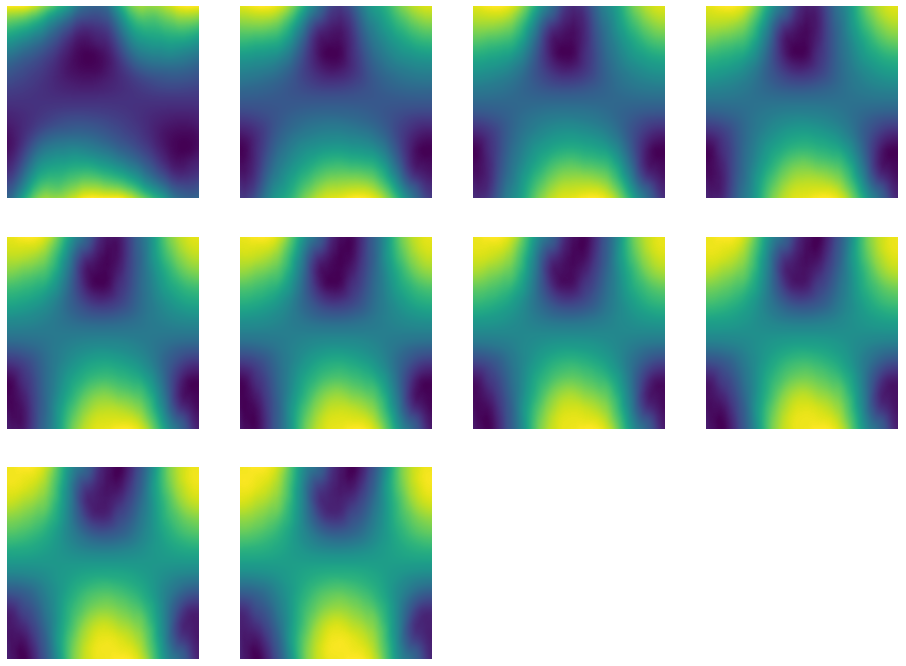

msa Layer 1:   0%|          | 0/100 [00:00<?, ?it/s]

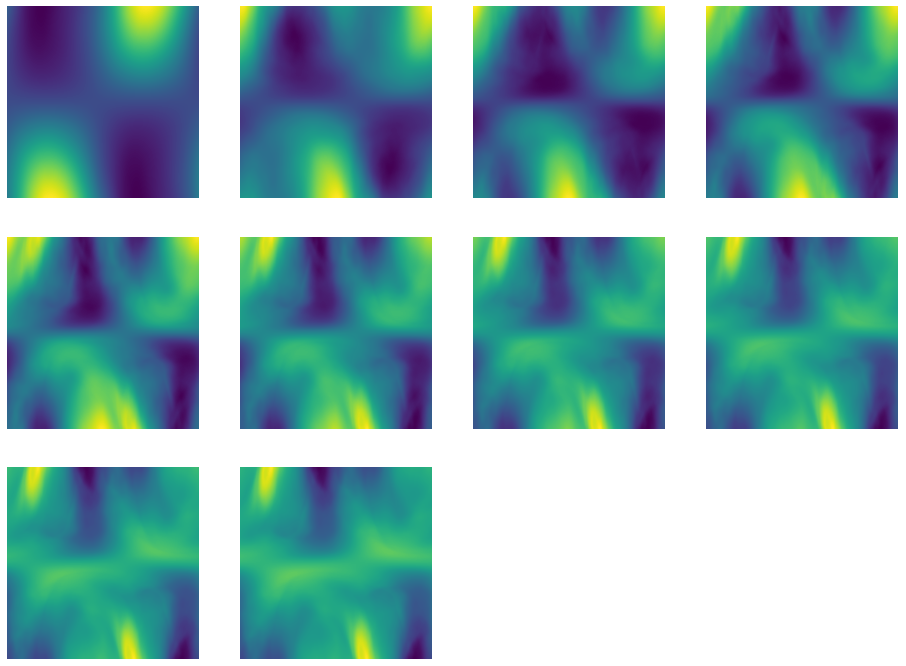

msa Layer 2:   0%|          | 0/100 [00:00<?, ?it/s]

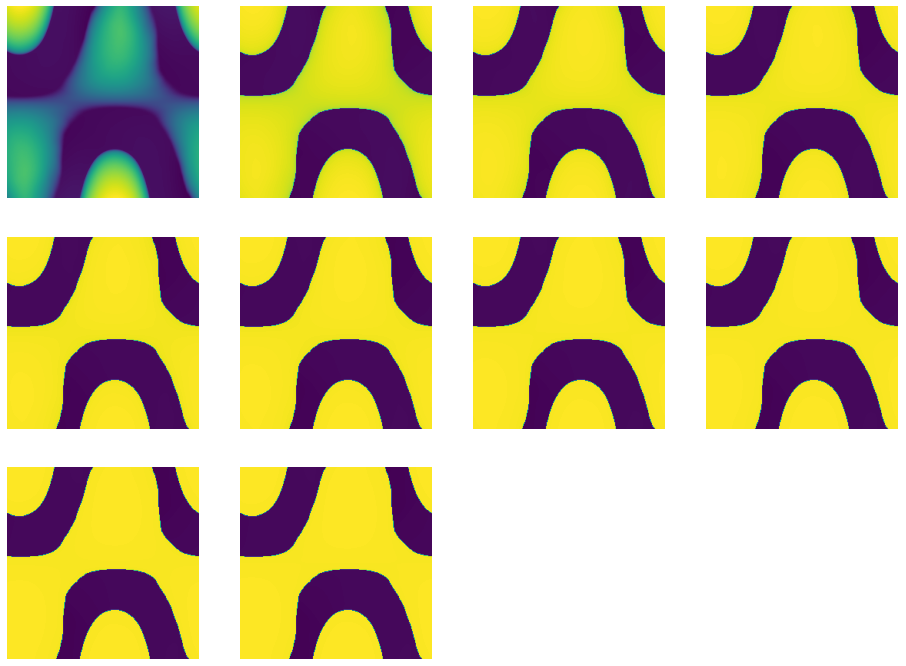

msa Layer 3:   0%|          | 0/100 [00:00<?, ?it/s]

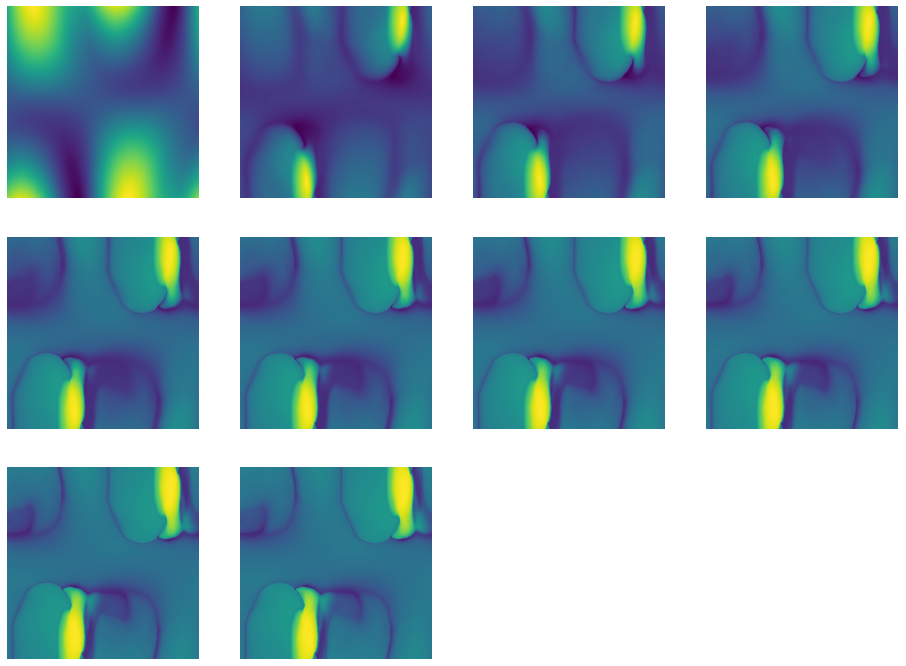

msa Layer 4:   0%|          | 0/100 [00:00<?, ?it/s]

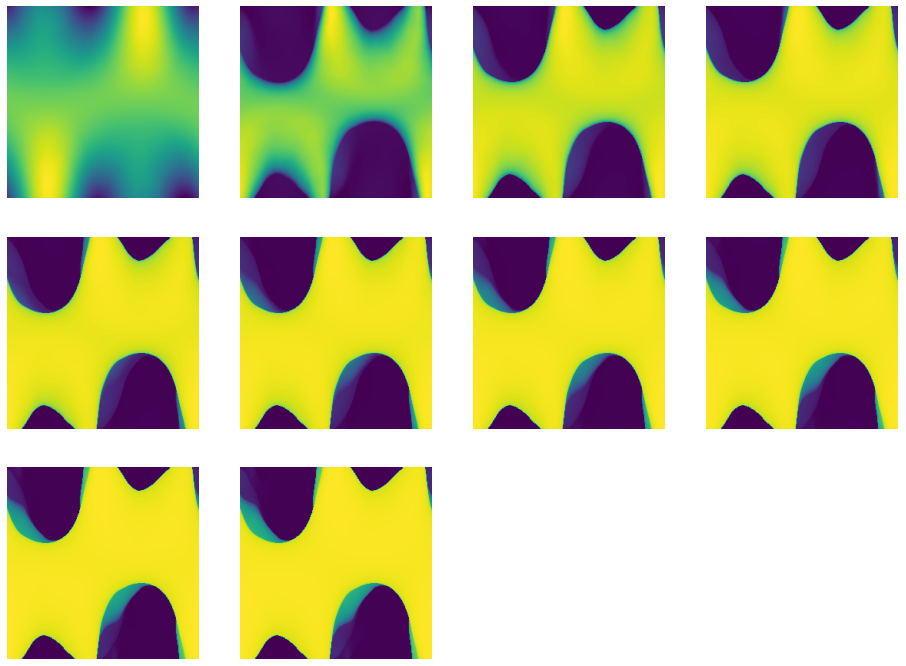

msa Layer 5:   0%|          | 0/100 [00:00<?, ?it/s]

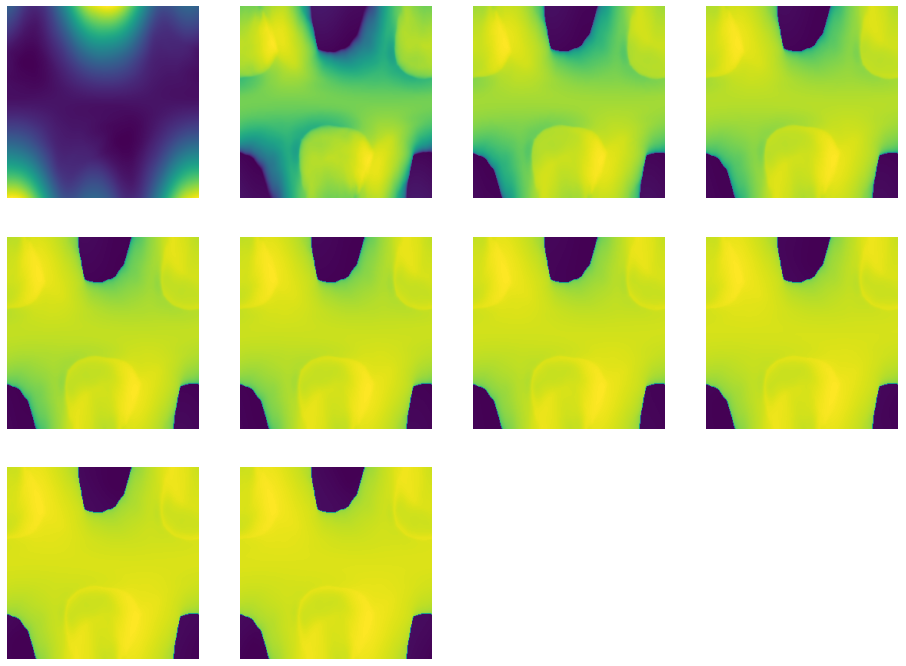

msa Layer 6:   0%|          | 0/100 [00:00<?, ?it/s]

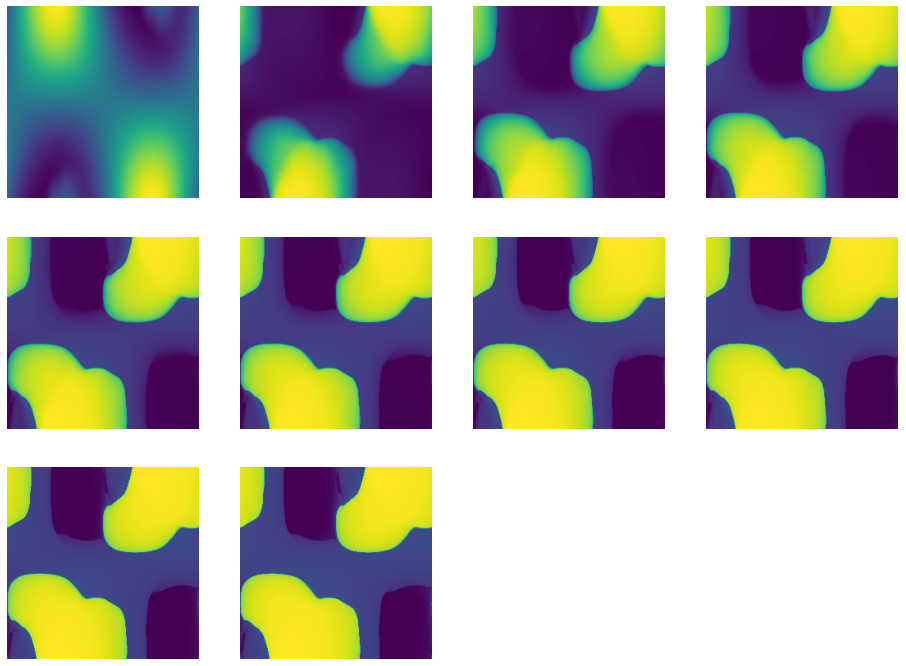

msa Layer 7:   0%|          | 0/100 [00:00<?, ?it/s]

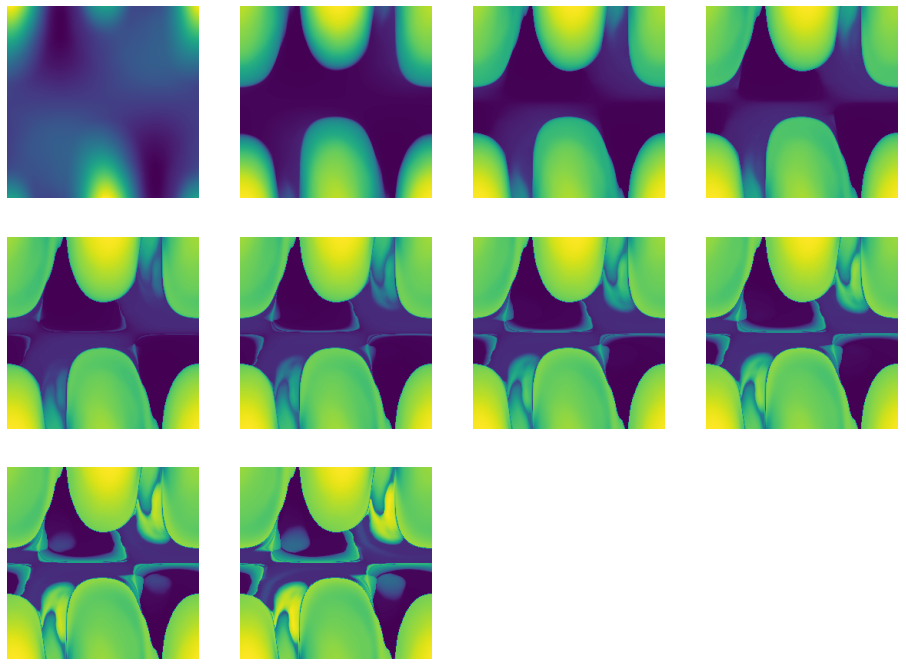

msa Layer 8:   0%|          | 0/100 [00:00<?, ?it/s]

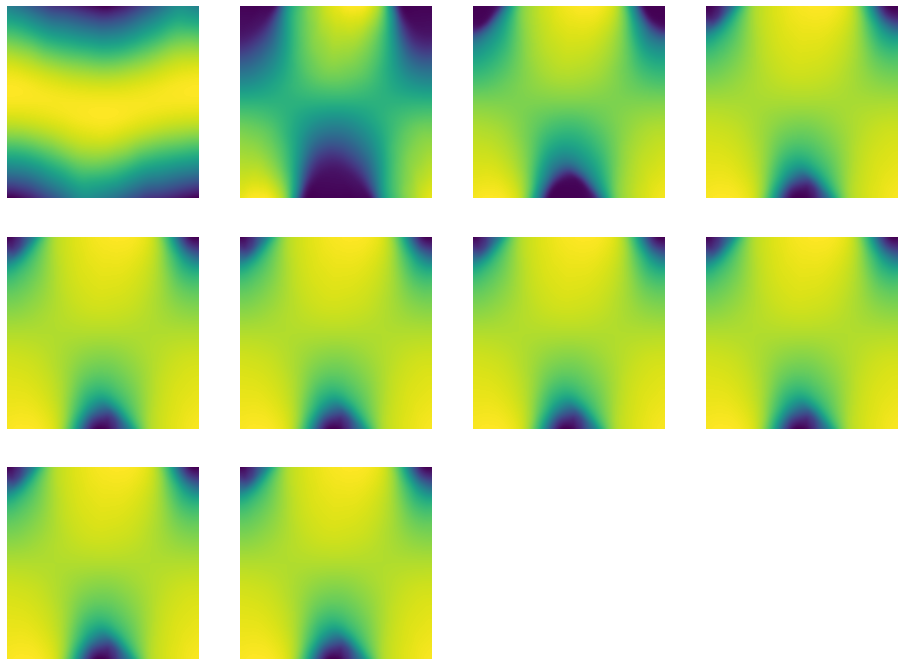

msa Layer 9:   0%|          | 0/100 [00:00<?, ?it/s]

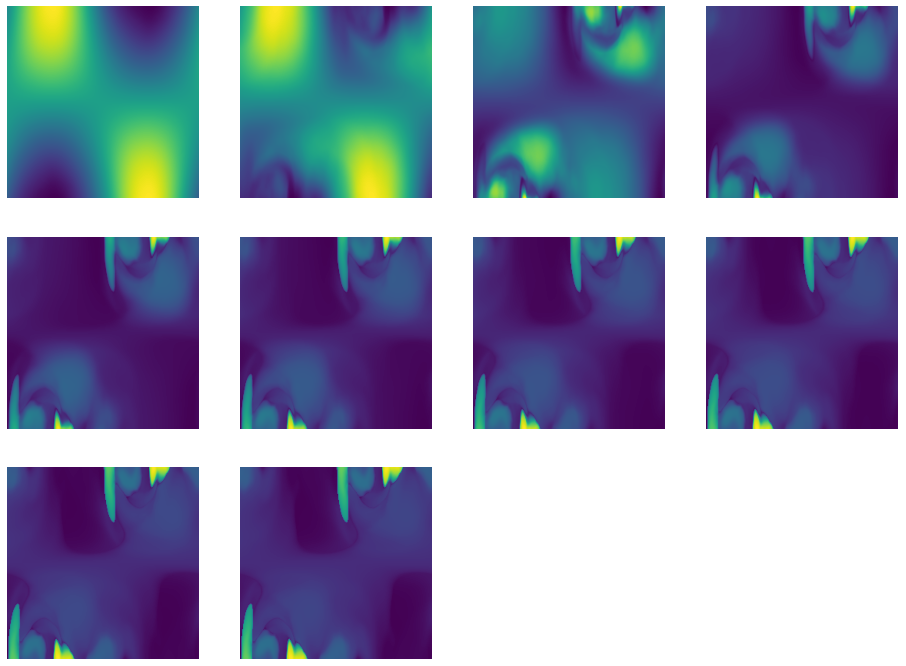

msa Layer 10:   0%|          | 0/100 [00:00<?, ?it/s]

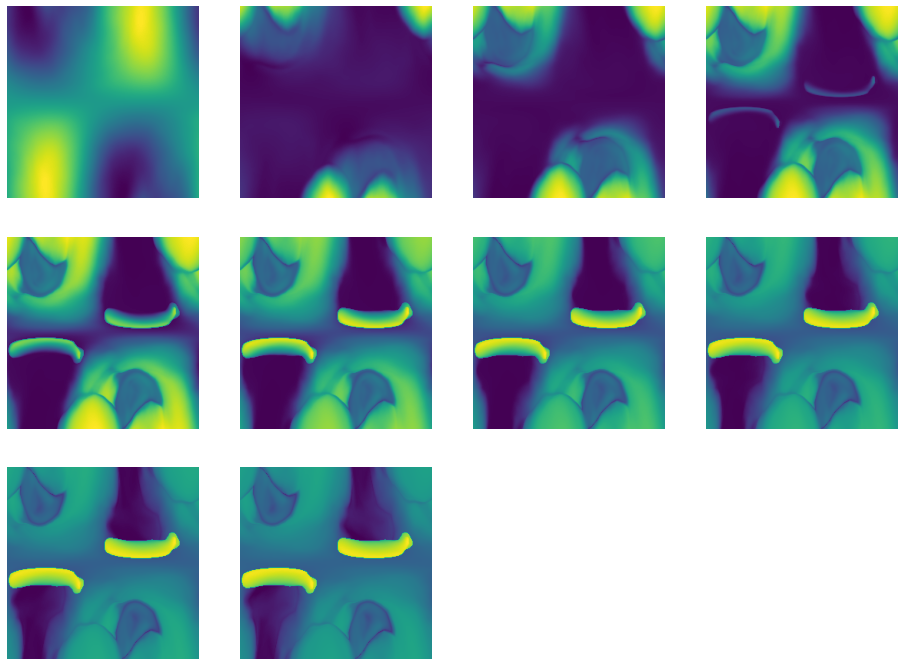

msa Layer 11:   0%|          | 0/100 [00:00<?, ?it/s]

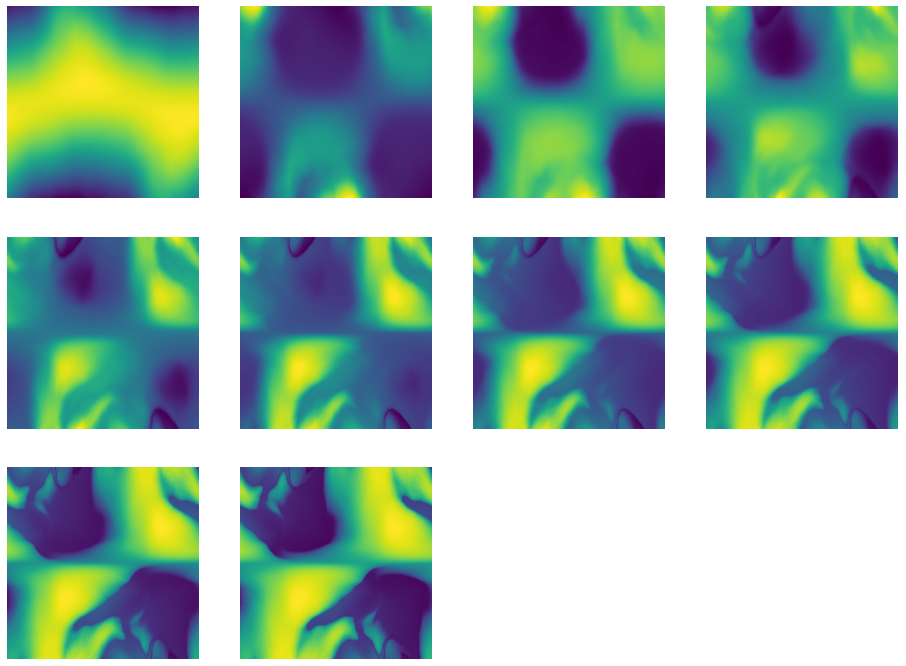

msa Layer 12:   0%|          | 0/100 [00:00<?, ?it/s]

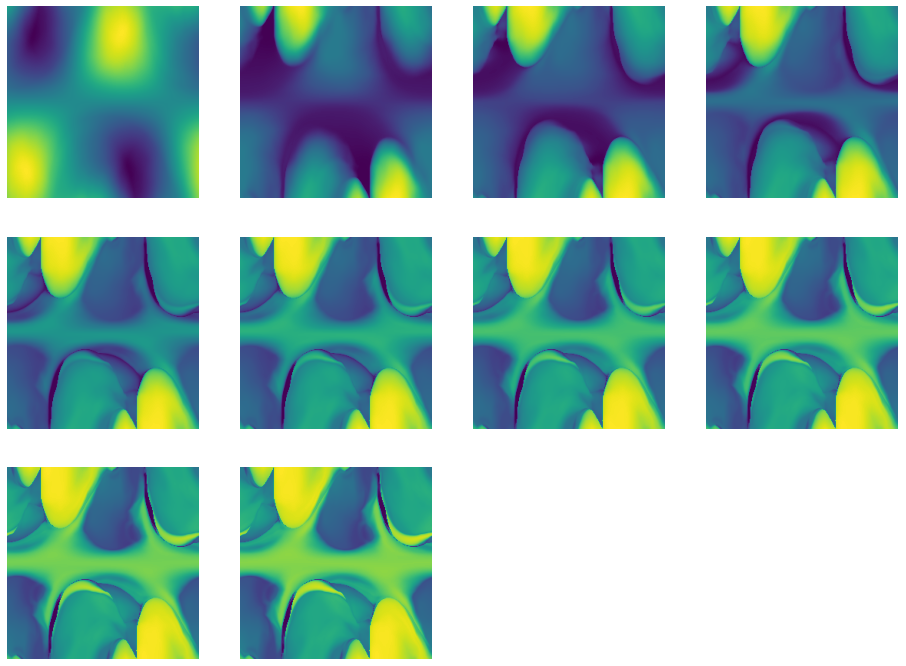

msa Layer 13:   0%|          | 0/100 [00:00<?, ?it/s]

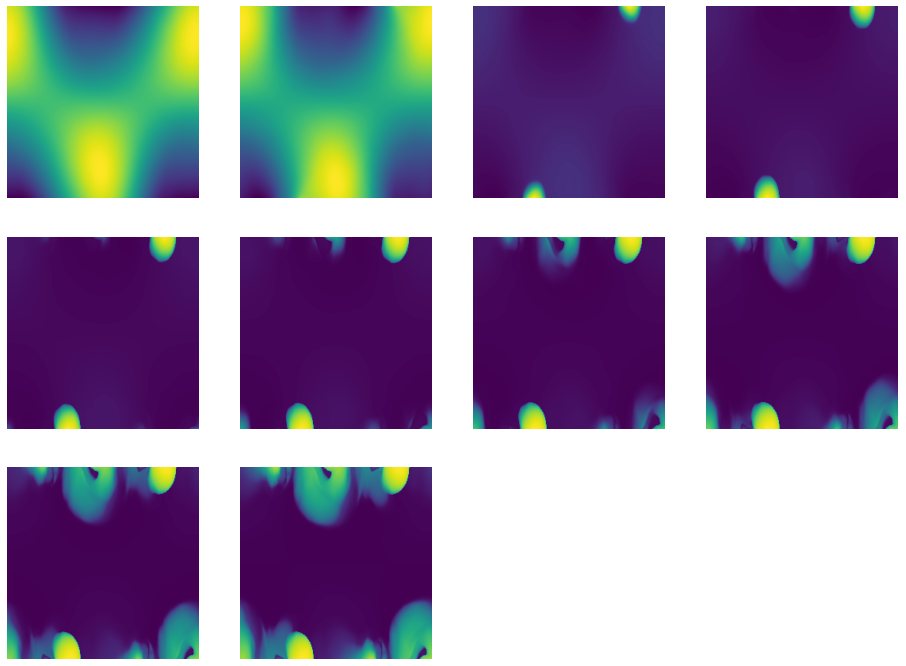

msa Layer 14:   0%|          | 0/100 [00:00<?, ?it/s]

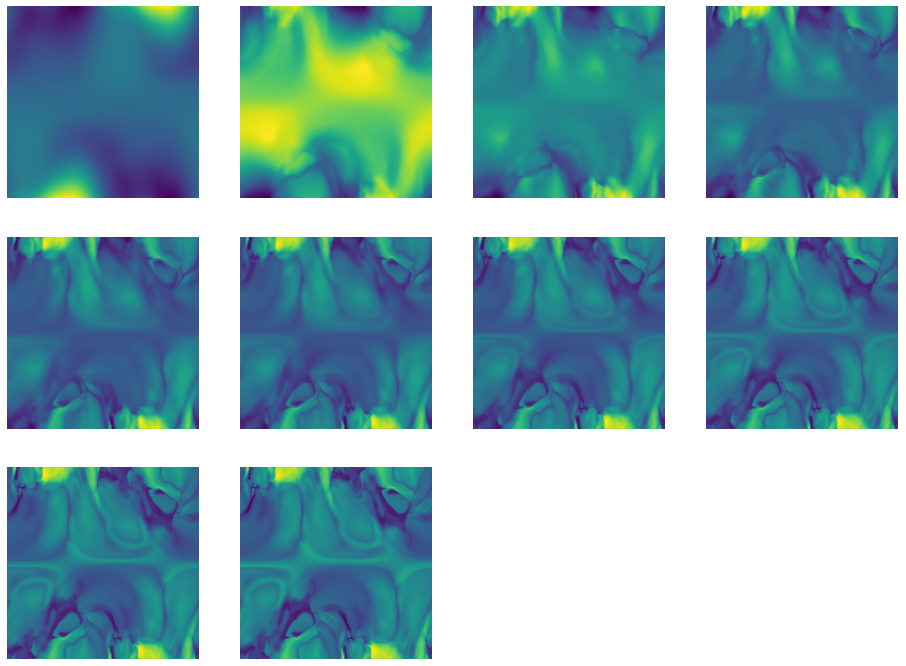

msa Layer 15:   0%|          | 0/100 [00:00<?, ?it/s]

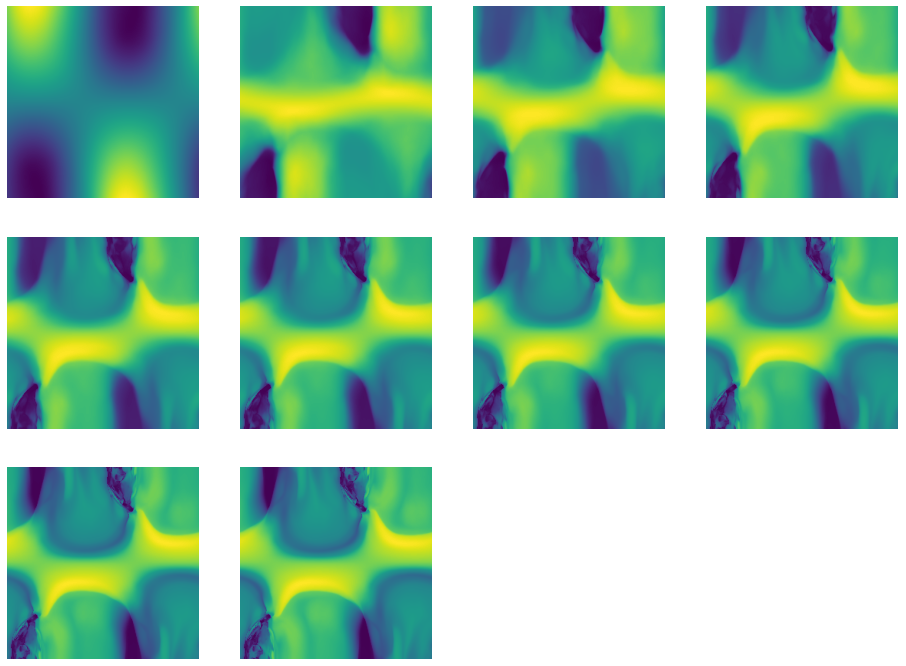

msa Layer 16:   0%|          | 0/100 [00:00<?, ?it/s]

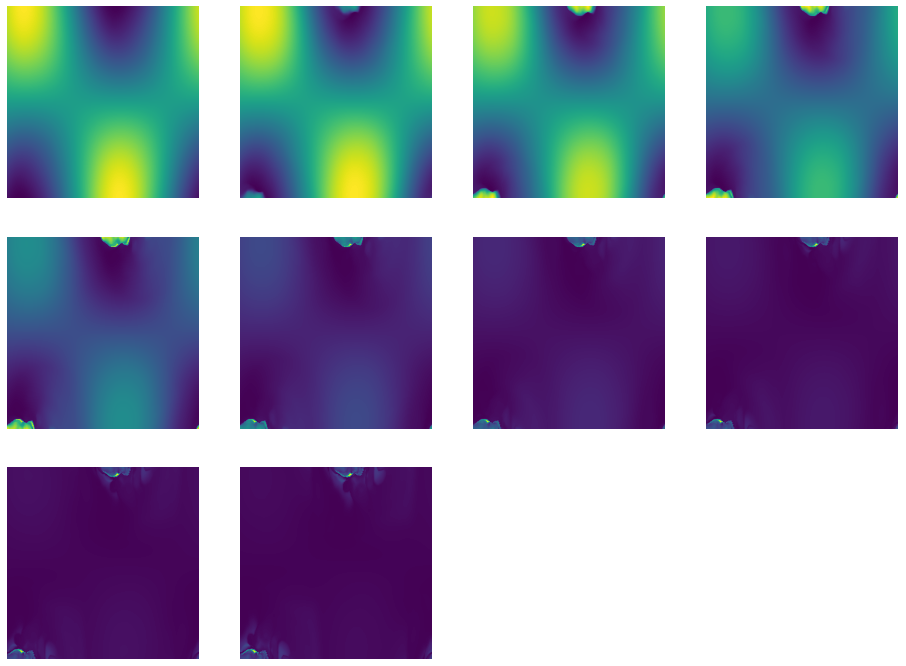

msa Layer 17:   0%|          | 0/100 [00:00<?, ?it/s]

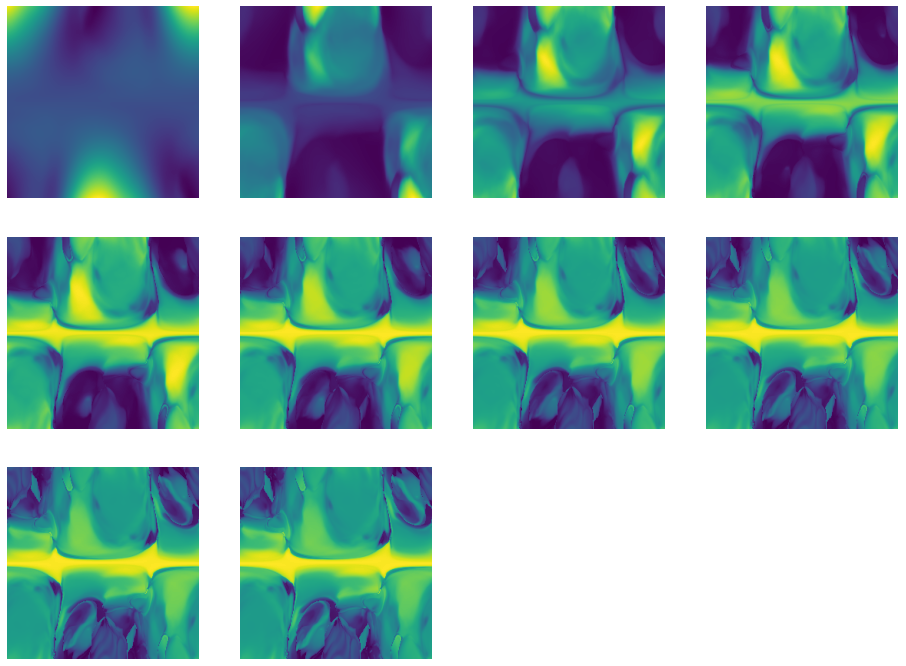

msa Layer 18:   0%|          | 0/100 [00:00<?, ?it/s]

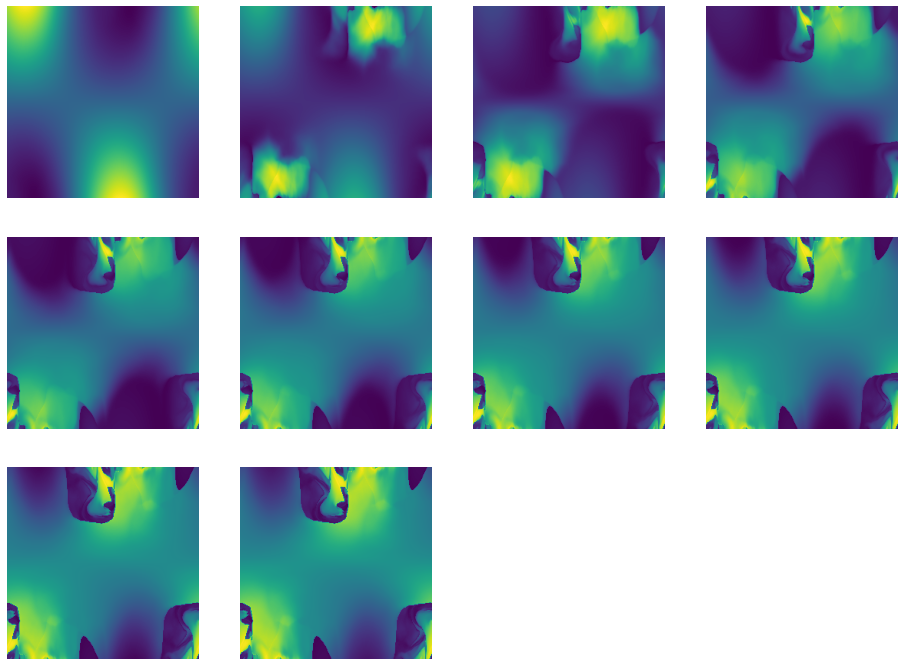

msa Layer 19:   0%|          | 0/100 [00:00<?, ?it/s]

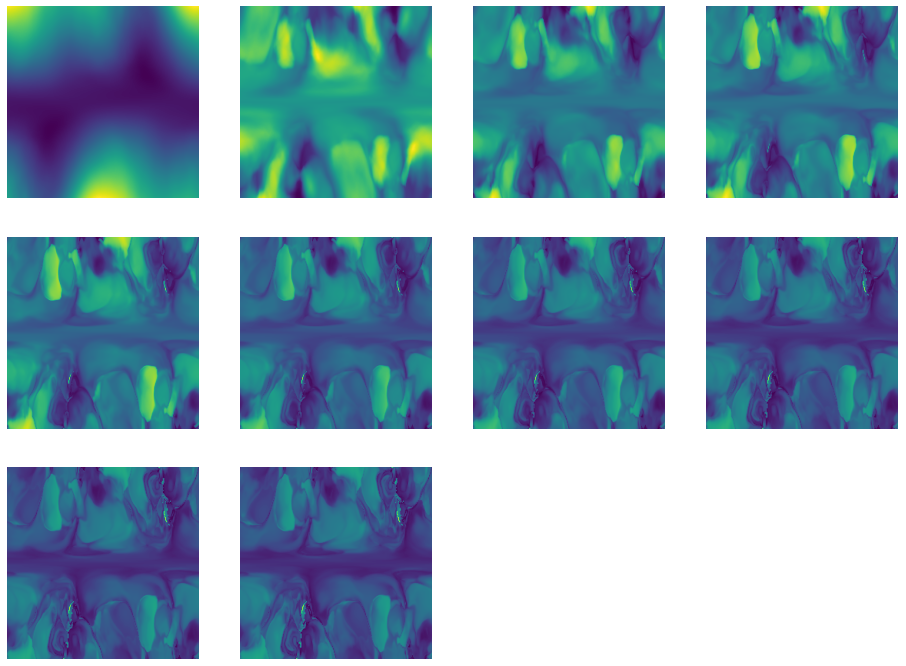

msa Layer 20:   0%|          | 0/100 [00:00<?, ?it/s]

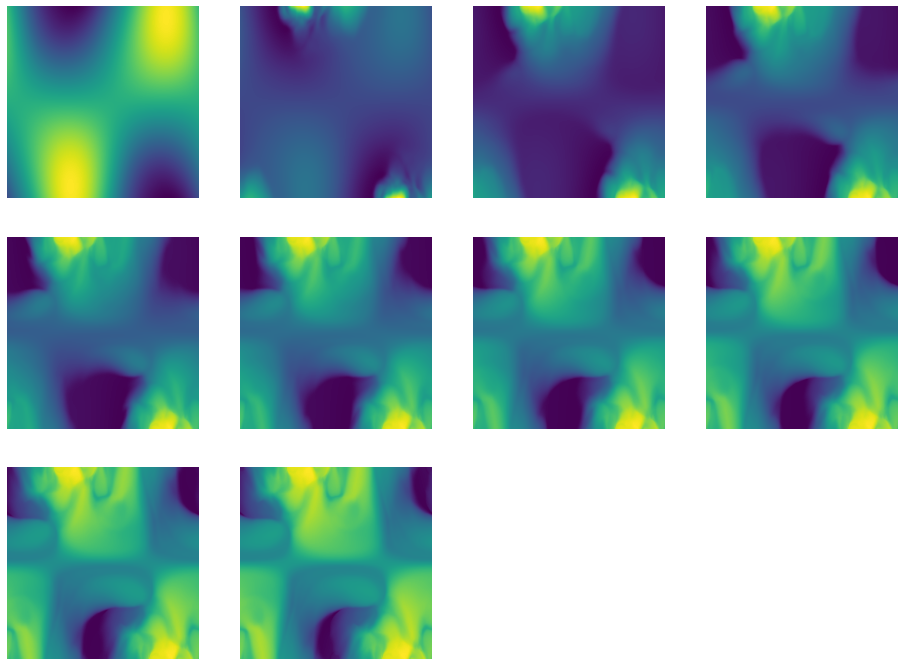

msa Layer 21:   0%|          | 0/100 [00:00<?, ?it/s]

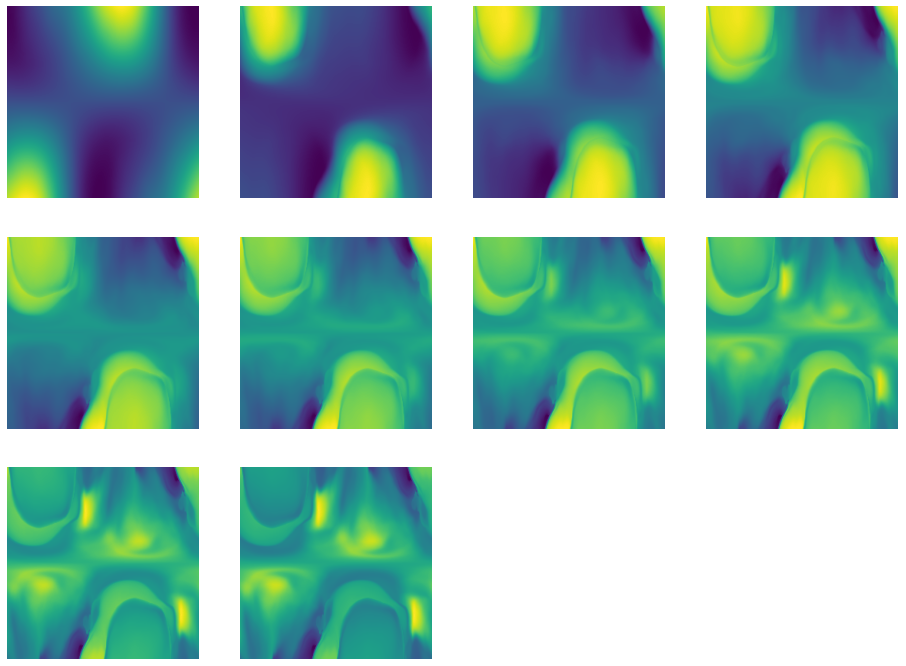

msa Layer 22:   0%|          | 0/100 [00:00<?, ?it/s]

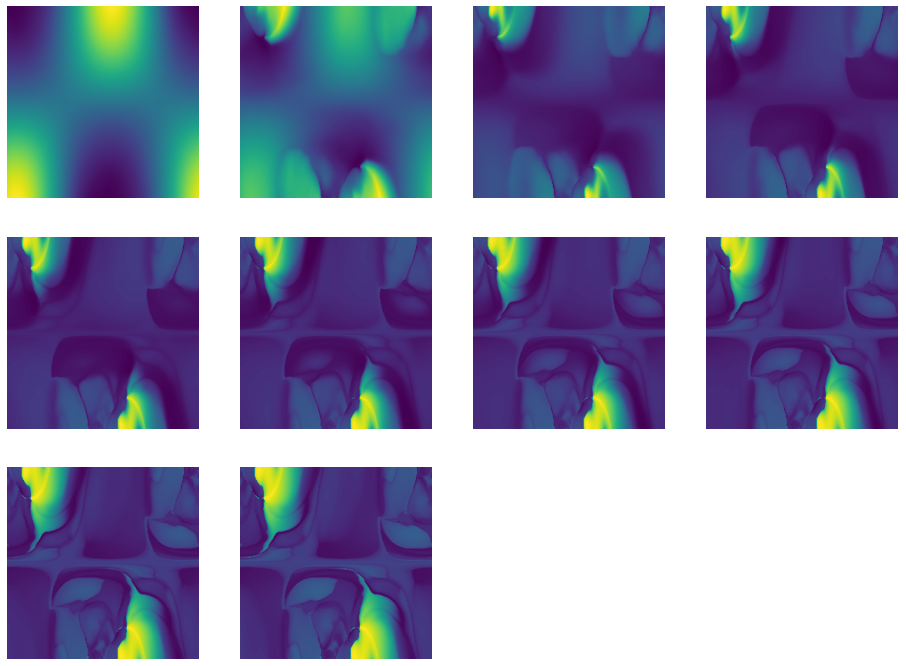

msa Layer 23:   0%|          | 0/100 [00:00<?, ?it/s]

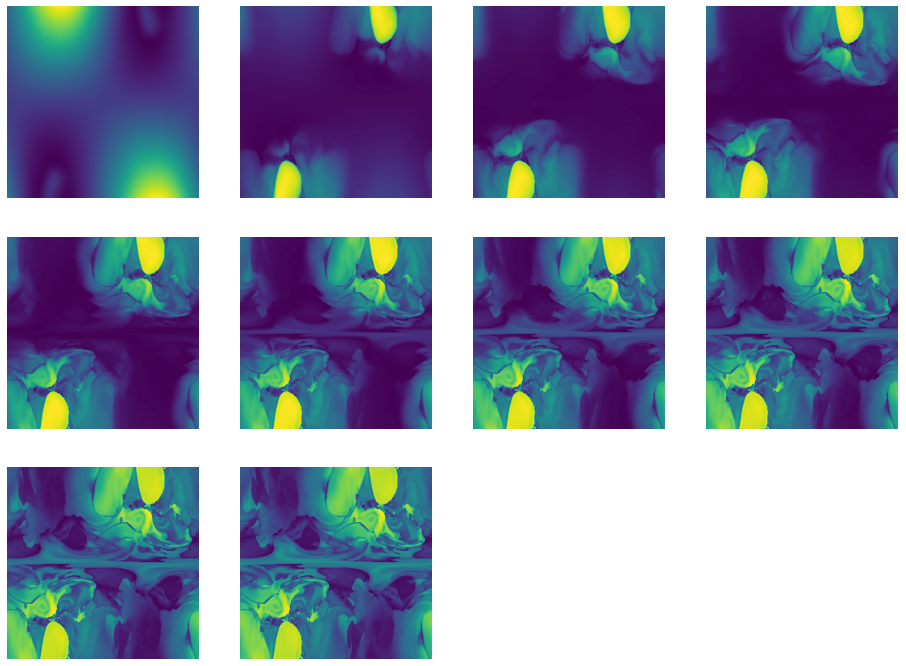

msa Layer 24:   0%|          | 0/100 [00:00<?, ?it/s]

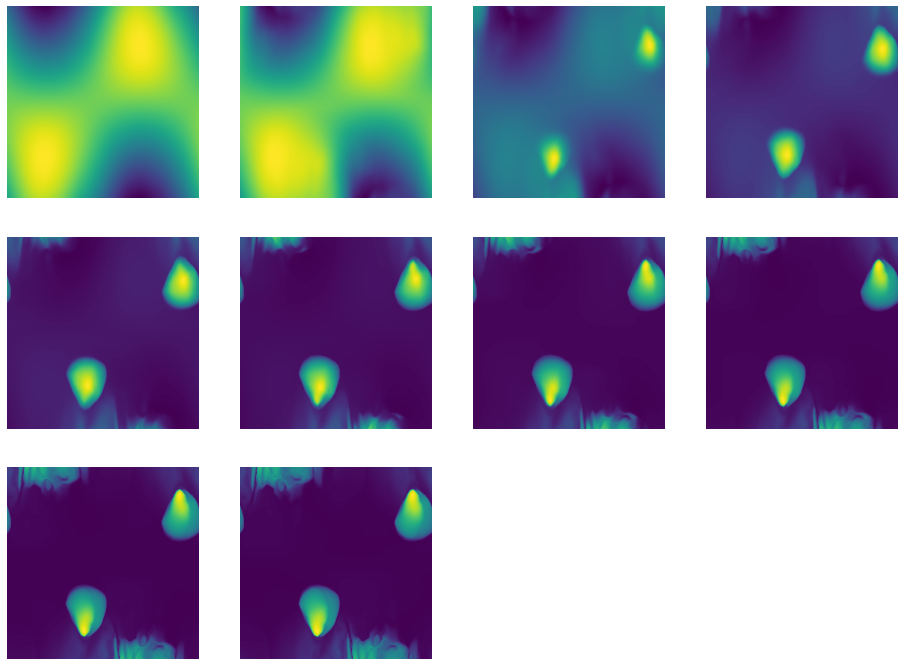

msa Layer 25:   0%|          | 0/100 [00:00<?, ?it/s]

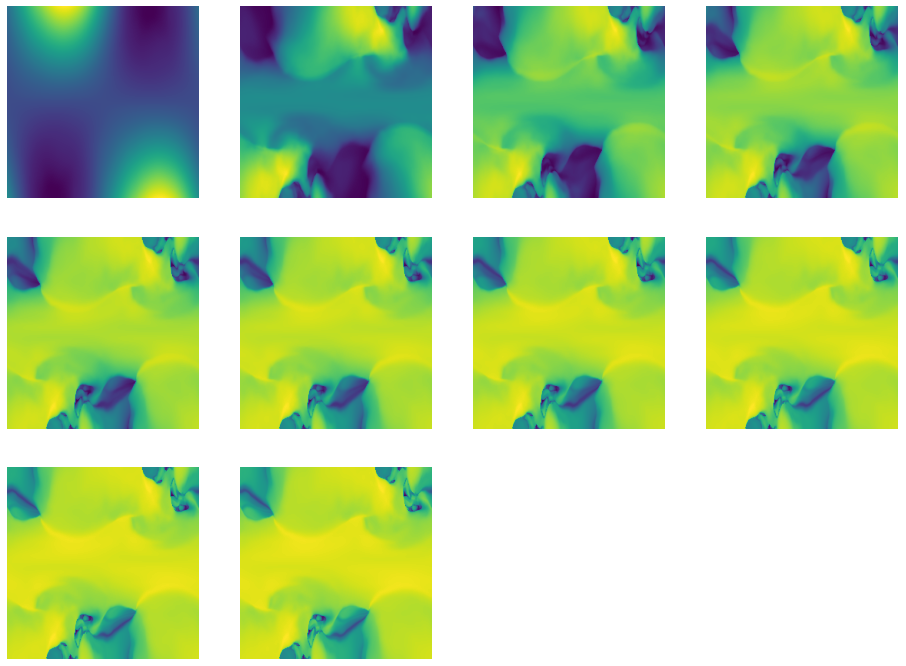

msa Layer 26:   0%|          | 0/100 [00:00<?, ?it/s]

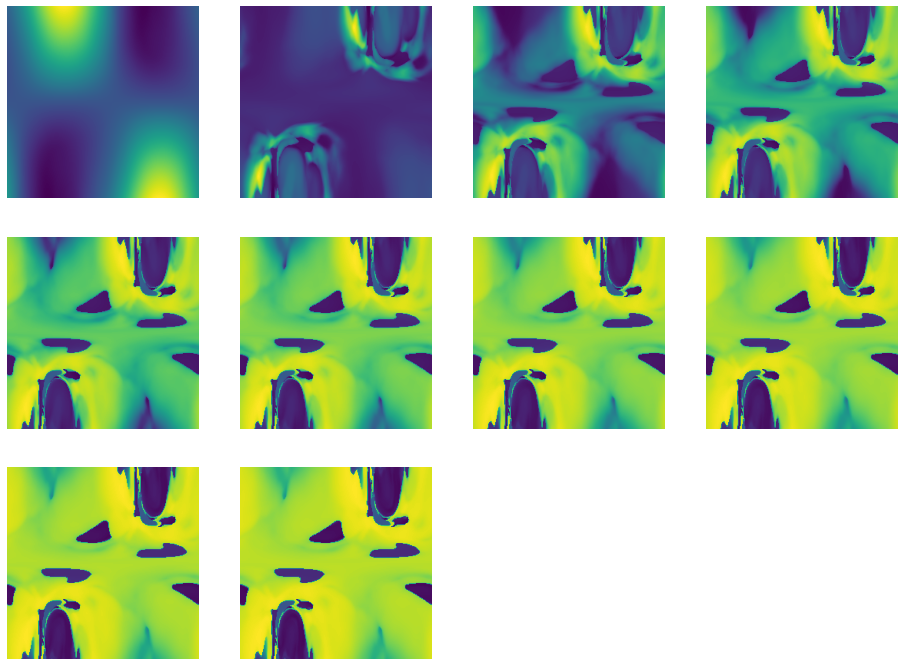

msa Layer 27:   0%|          | 0/100 [00:00<?, ?it/s]

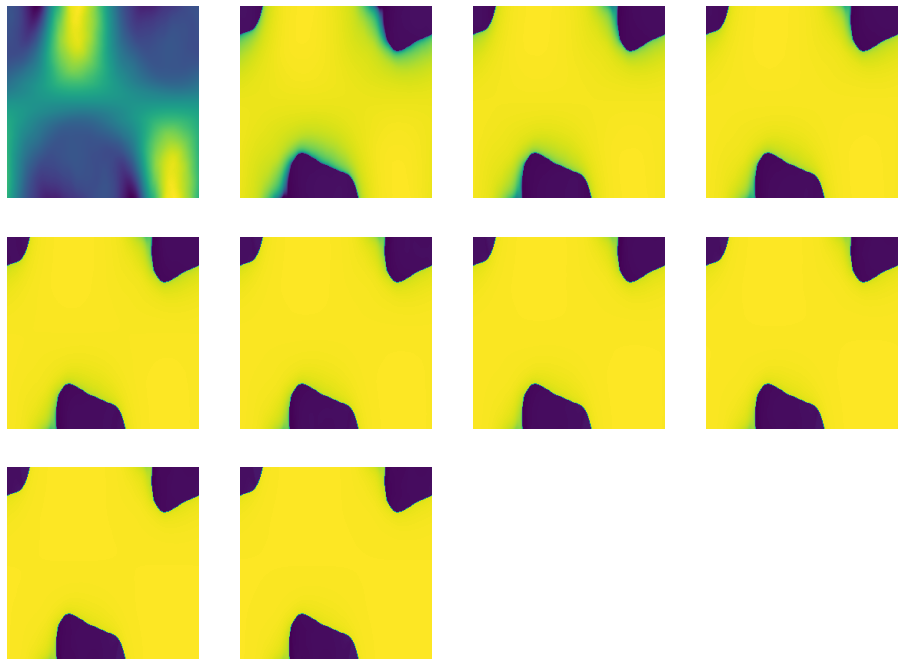

msa Layer 28:   0%|          | 0/100 [00:00<?, ?it/s]

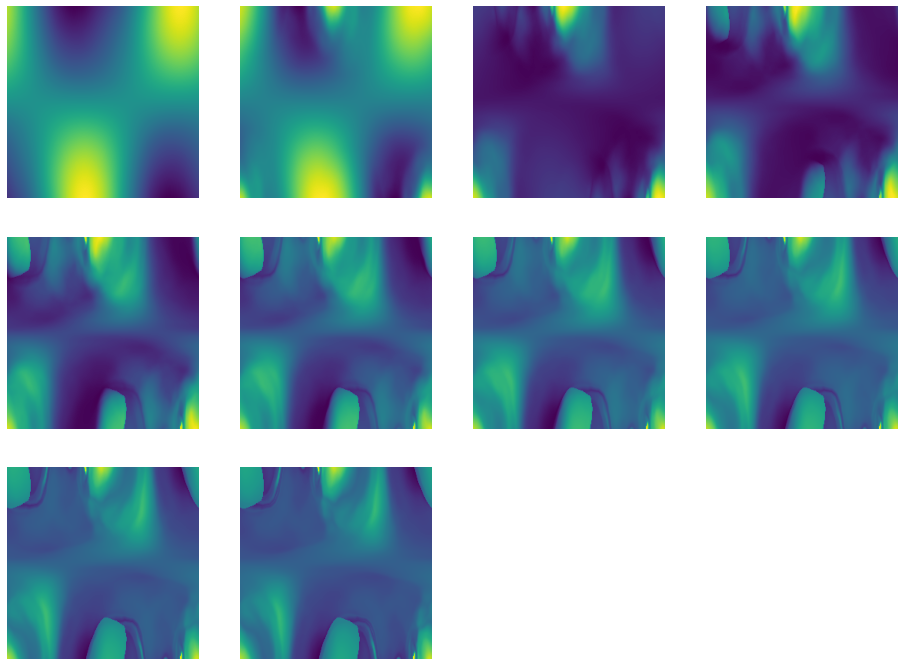

msa Layer 29:   0%|          | 0/100 [00:00<?, ?it/s]

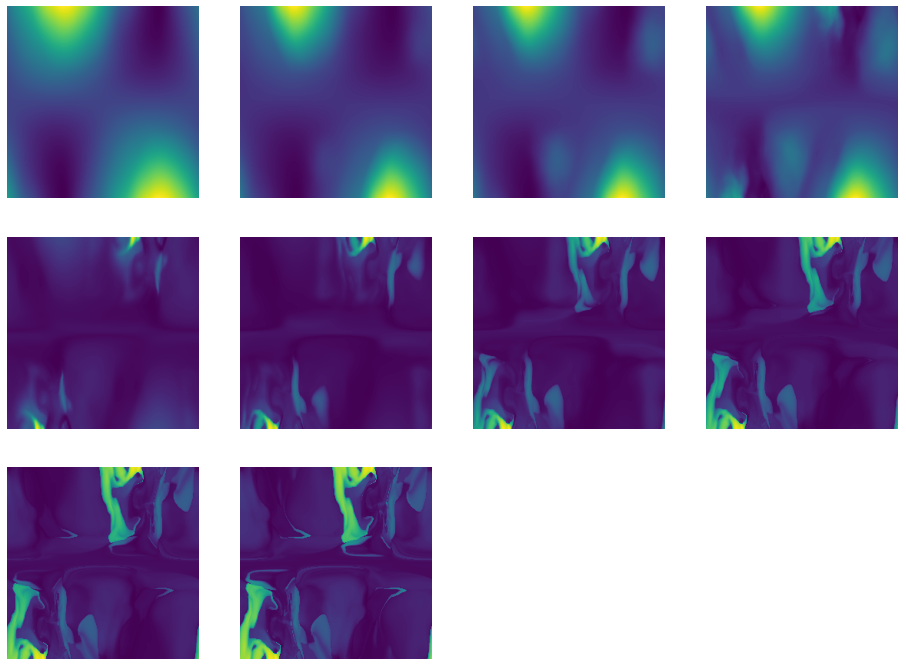

msa Layer 30:   0%|          | 0/100 [00:00<?, ?it/s]

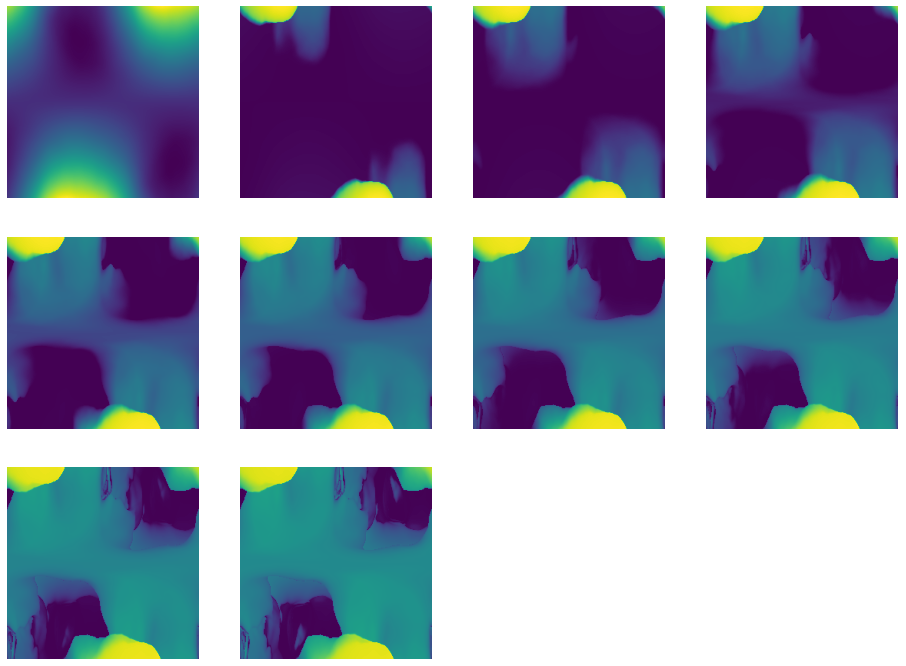

msa Layer 31:   0%|          | 0/100 [00:00<?, ?it/s]

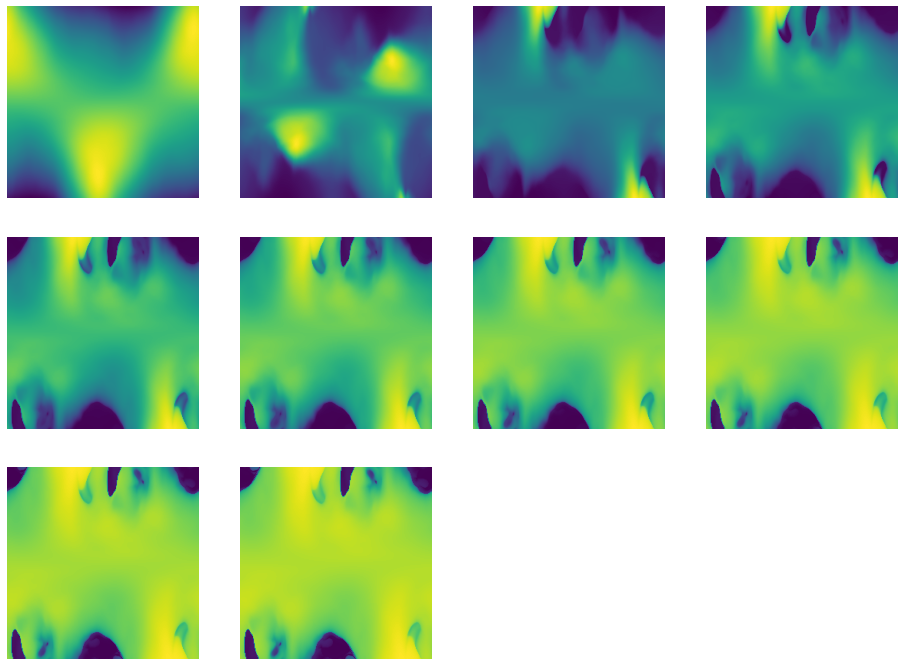

msa Layer 32:   0%|          | 0/100 [00:00<?, ?it/s]

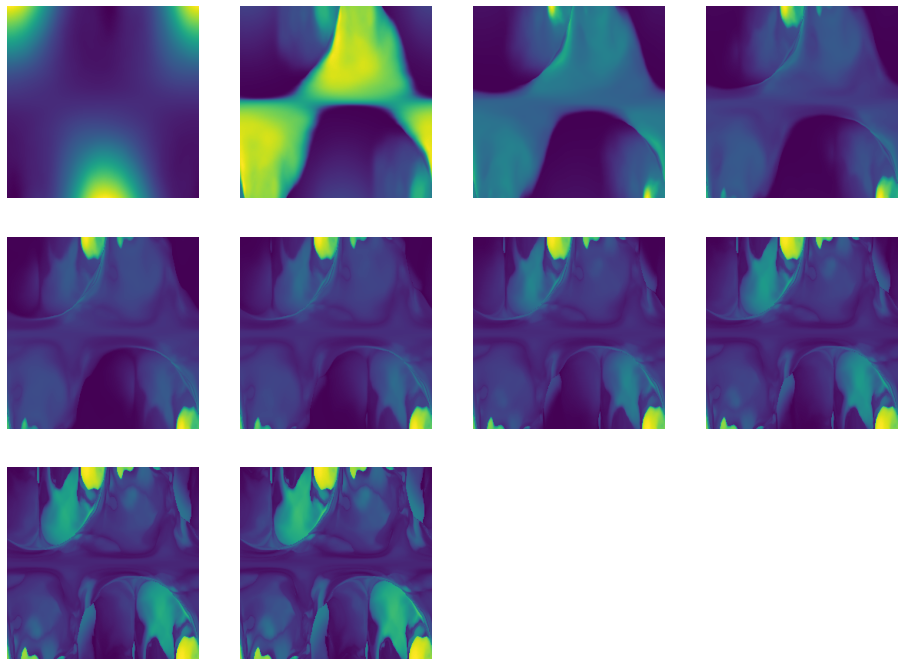

msa Layer 33:   0%|          | 0/100 [00:00<?, ?it/s]

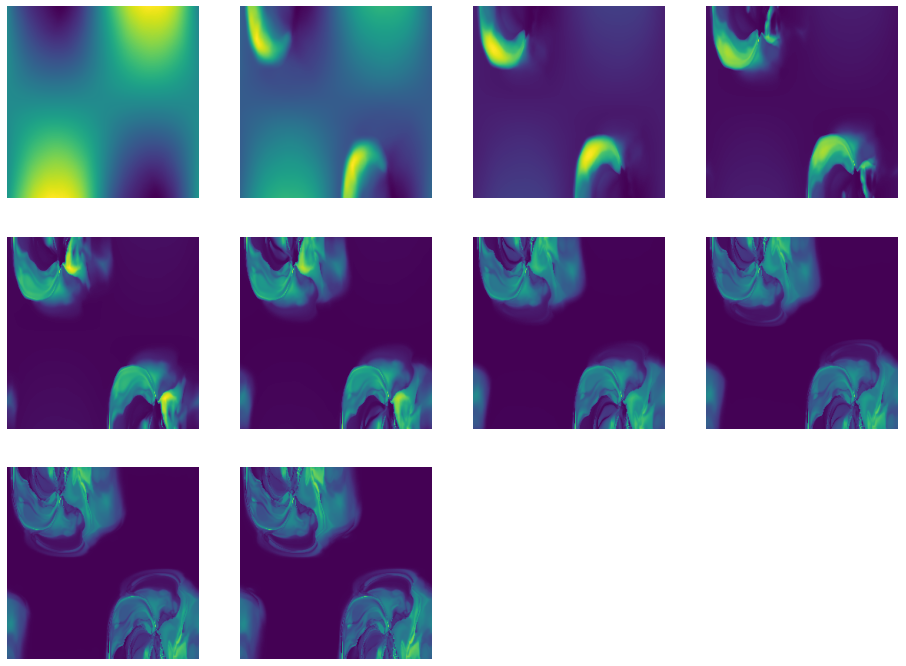

msa Layer 34:   0%|          | 0/100 [00:00<?, ?it/s]

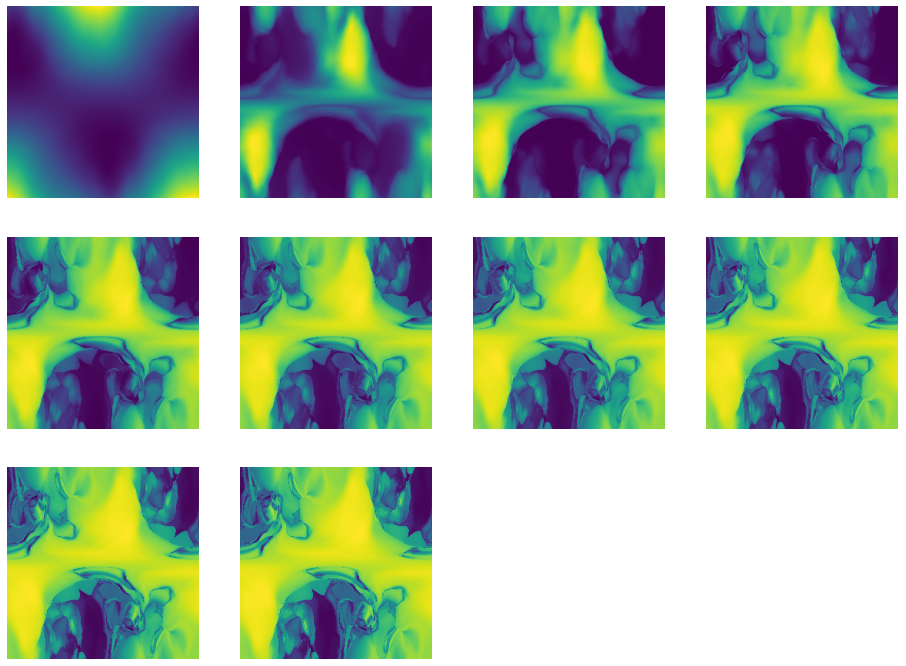

msa Layer 35:   0%|          | 0/100 [00:00<?, ?it/s]

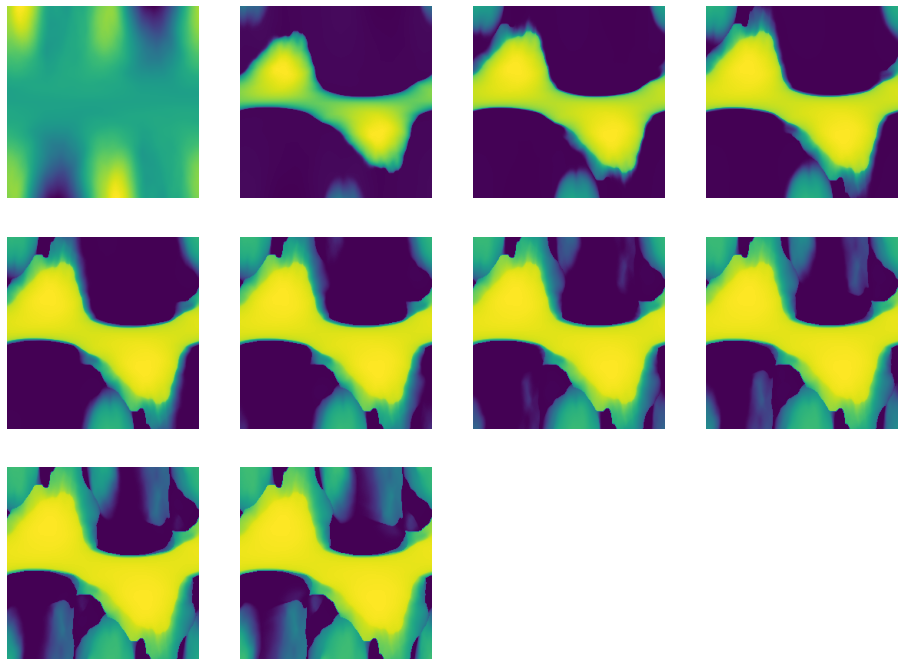

msa Layer 36:   0%|          | 0/100 [00:00<?, ?it/s]

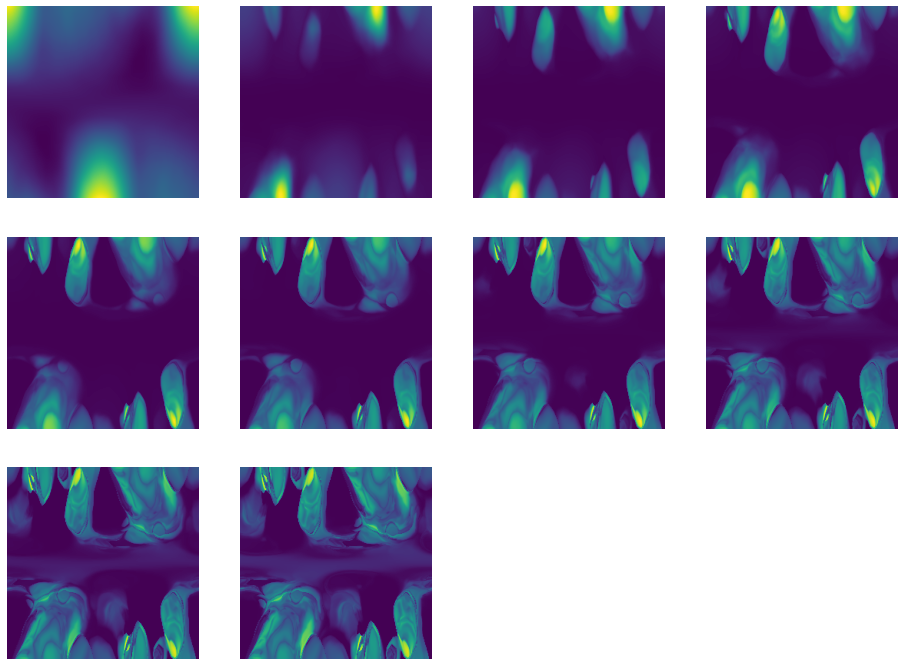

msa Layer 37:   0%|          | 0/100 [00:00<?, ?it/s]

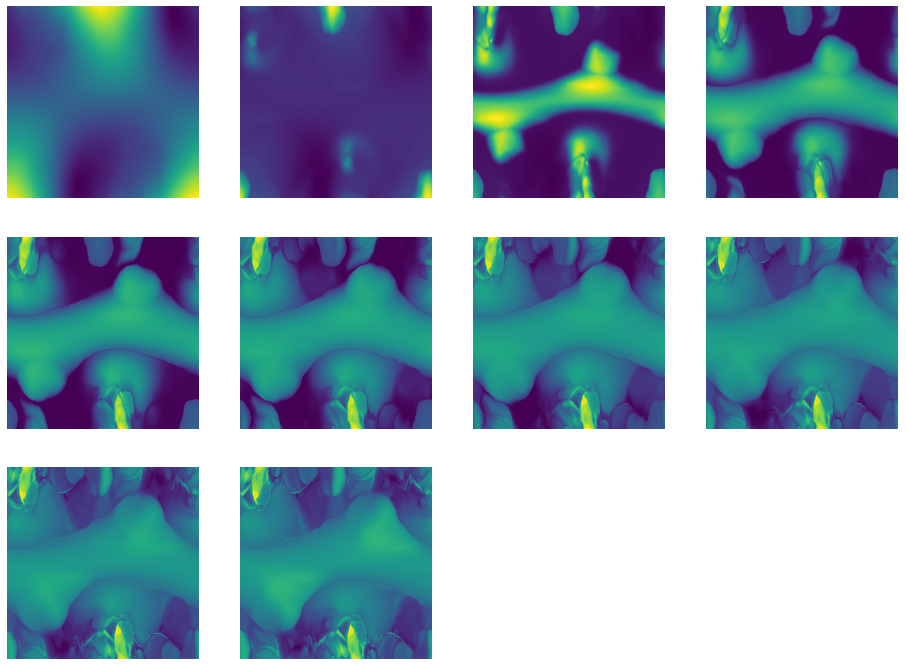

msa Layer 38:   0%|          | 0/100 [00:00<?, ?it/s]

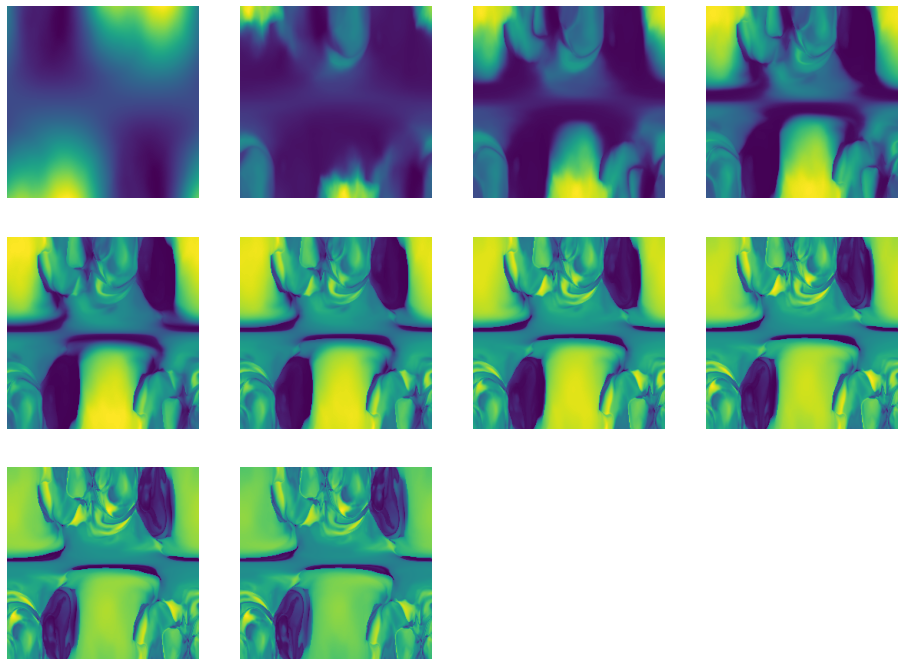

msa Layer 39:   0%|          | 0/100 [00:00<?, ?it/s]

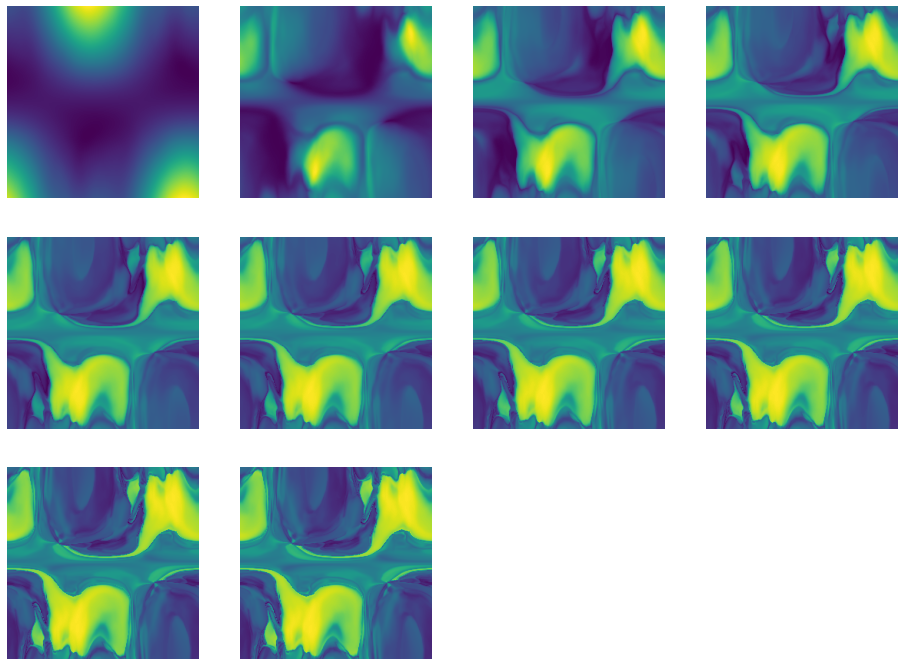

msa Layer 40:   0%|          | 0/100 [00:00<?, ?it/s]

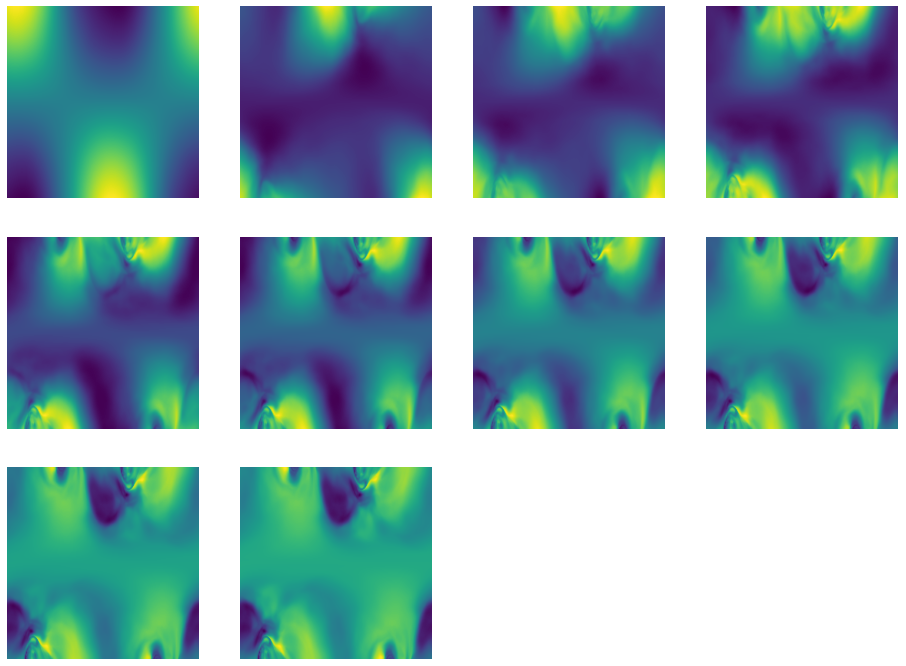

msa Layer 41:   0%|          | 0/100 [00:00<?, ?it/s]

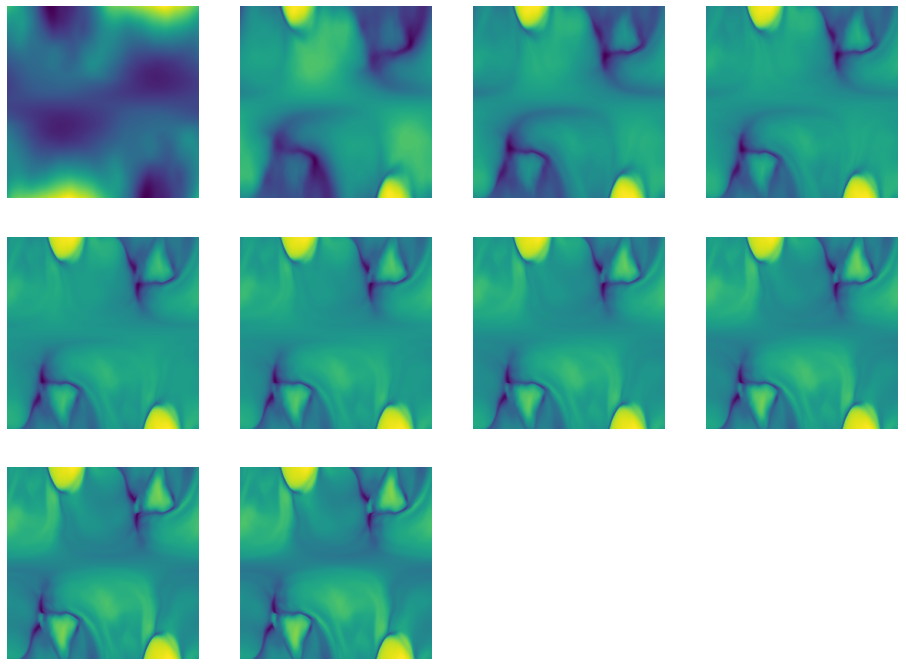

msa Layer 42:   0%|          | 0/100 [00:00<?, ?it/s]

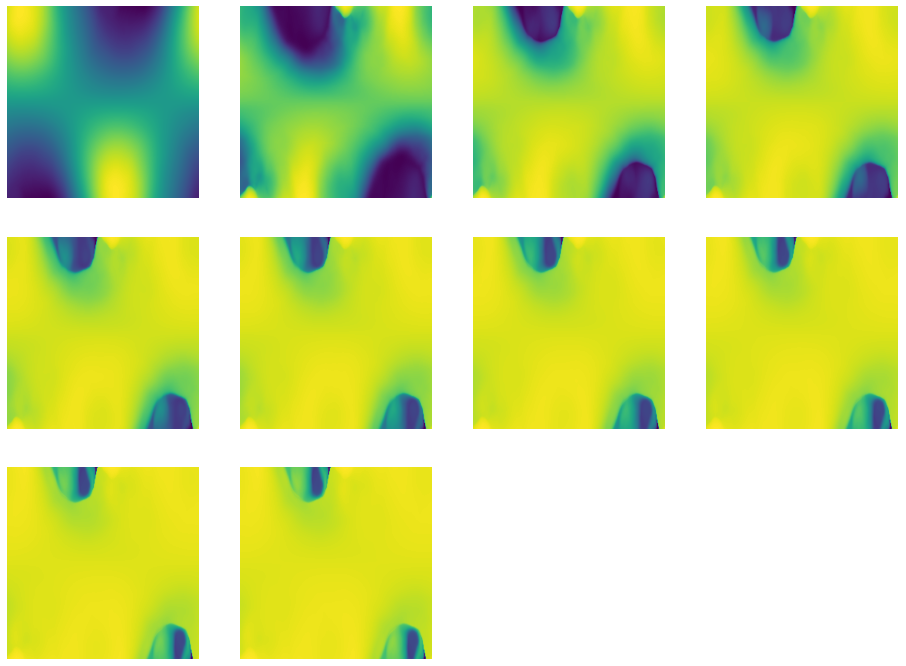

msa Layer 43:   0%|          | 0/100 [00:00<?, ?it/s]

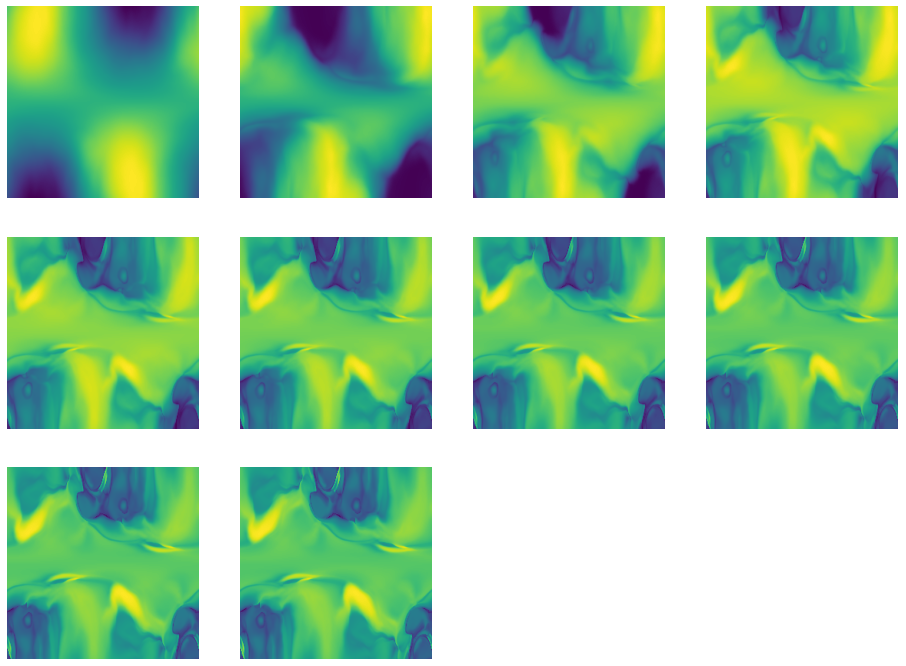

msa Layer 44:   0%|          | 0/100 [00:00<?, ?it/s]

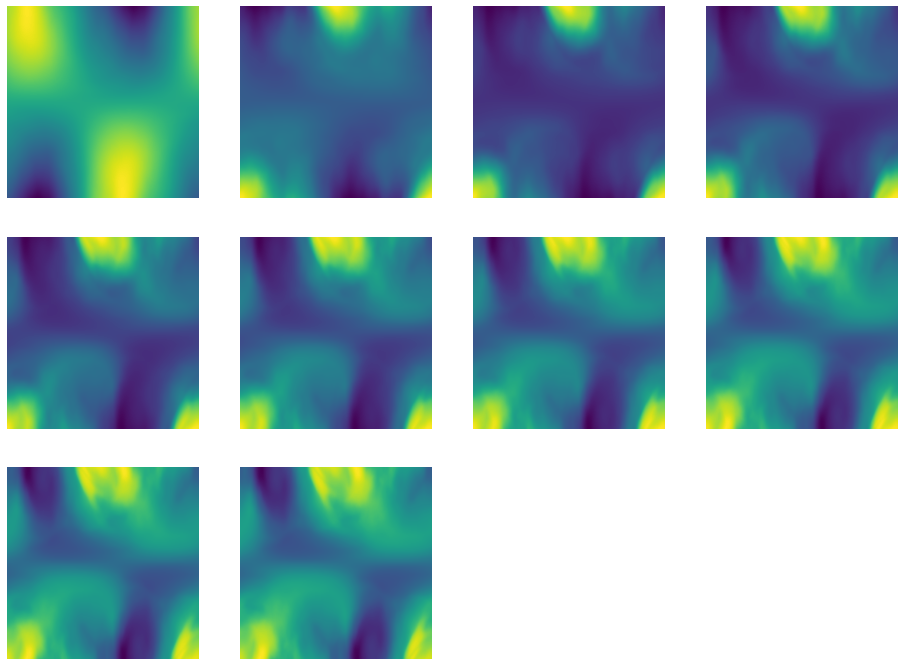

msa Layer 45:   0%|          | 0/100 [00:00<?, ?it/s]

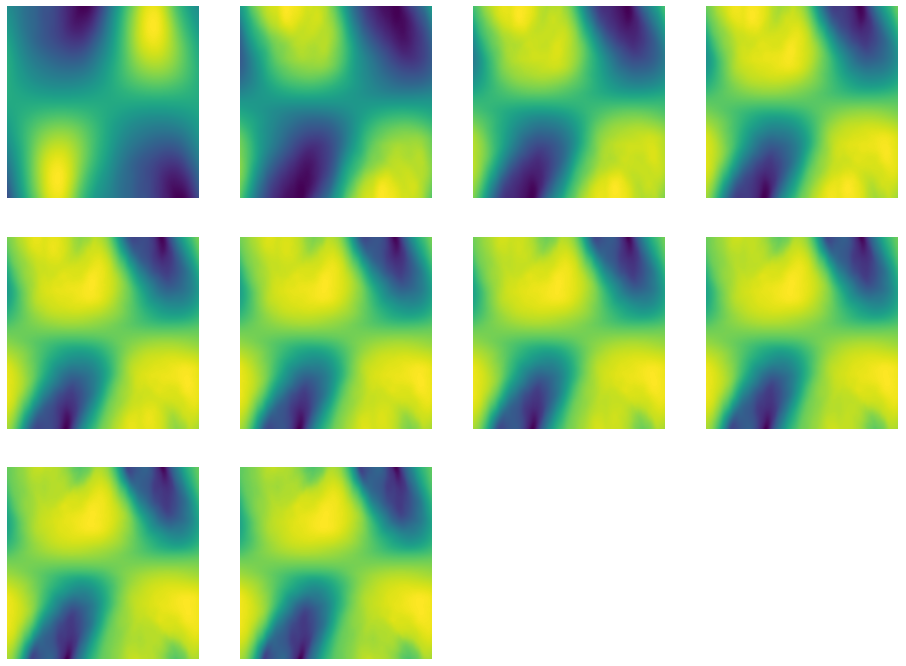

msa Layer 46:   0%|          | 0/100 [00:00<?, ?it/s]

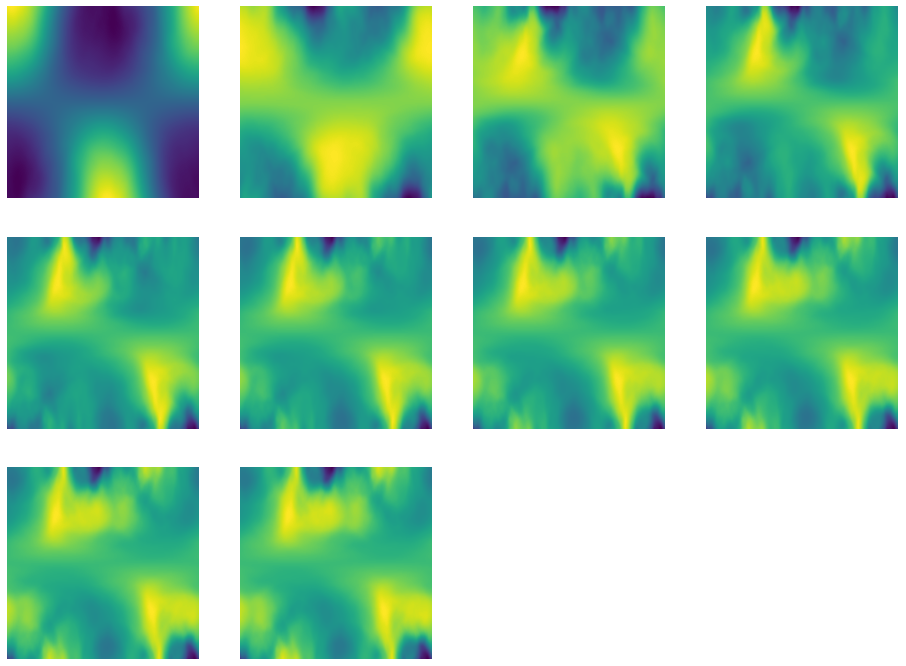

msa Layer 47:   0%|          | 0/100 [00:00<?, ?it/s]

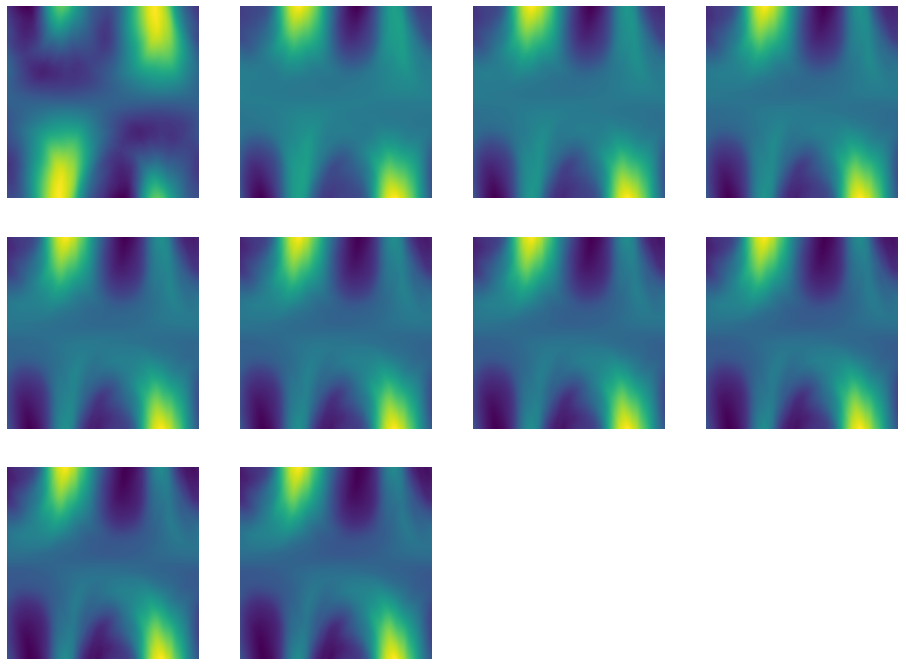

pair Layer 0:   0%|          | 0/100 [00:00<?, ?it/s]

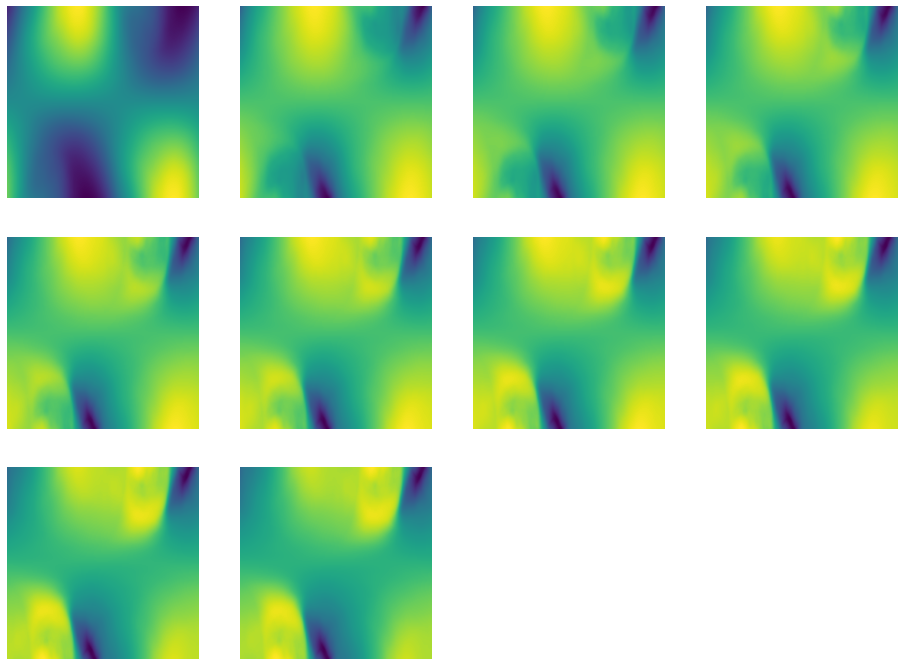

pair Layer 1:   0%|          | 0/100 [00:00<?, ?it/s]

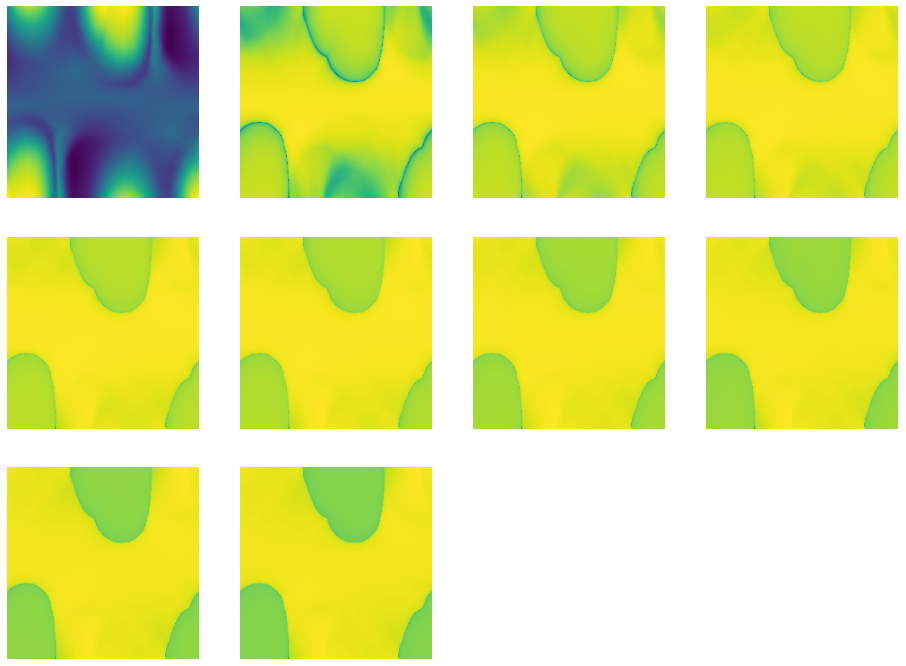

pair Layer 2:   0%|          | 0/100 [00:00<?, ?it/s]

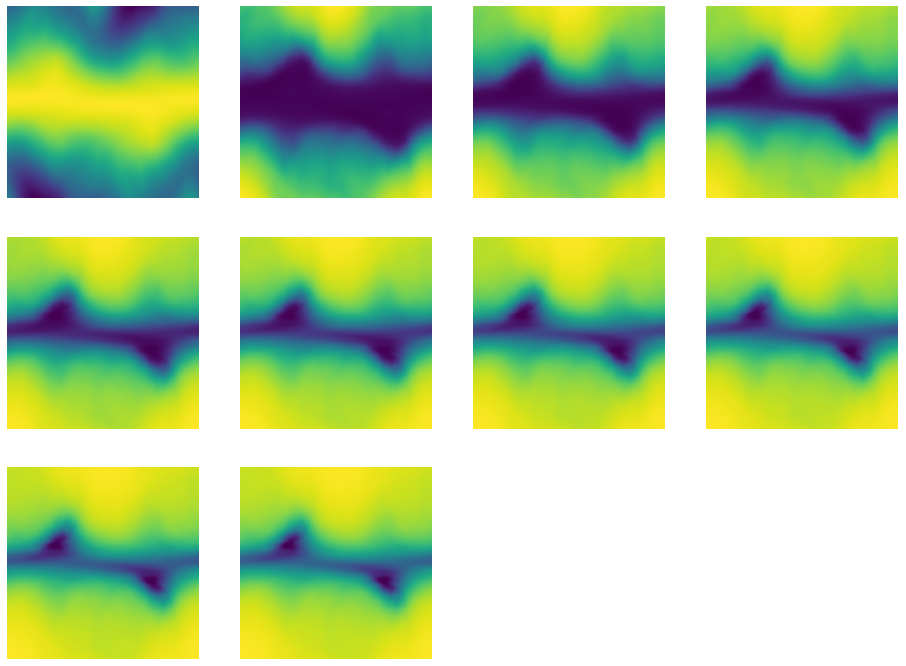

pair Layer 3:   0%|          | 0/100 [00:00<?, ?it/s]

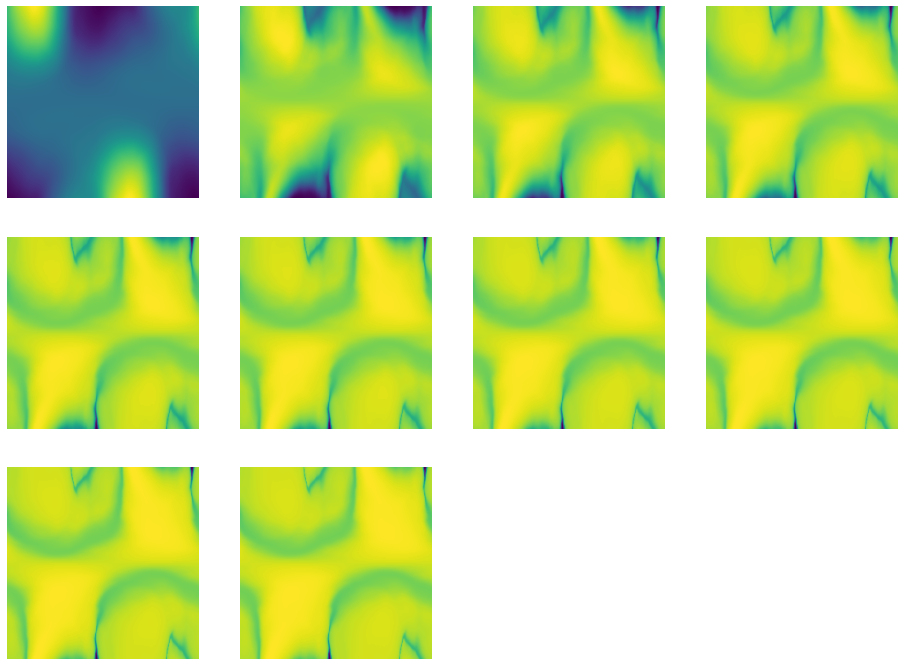

pair Layer 4:   0%|          | 0/100 [00:00<?, ?it/s]

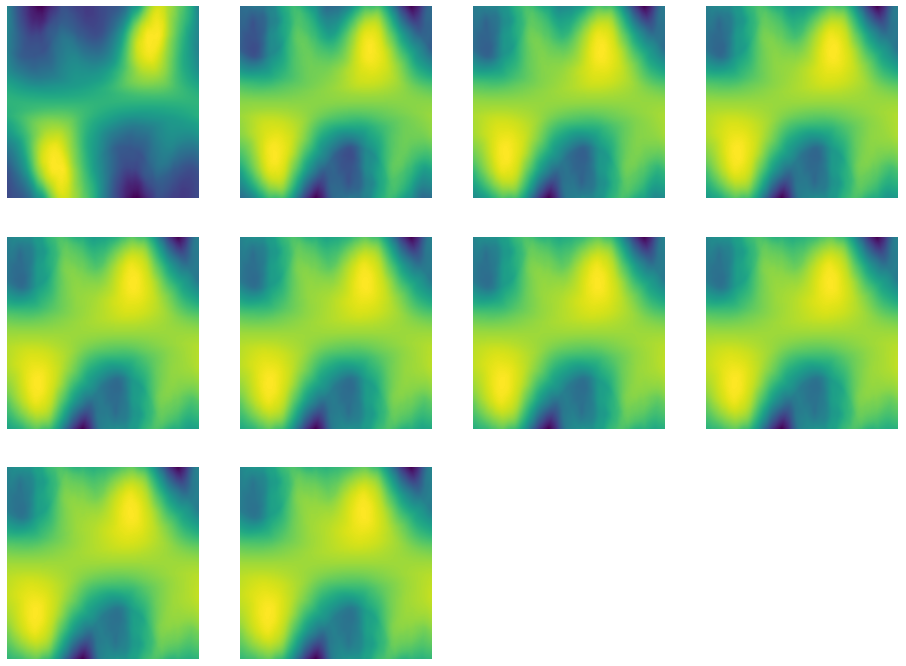

pair Layer 5:   0%|          | 0/100 [00:00<?, ?it/s]

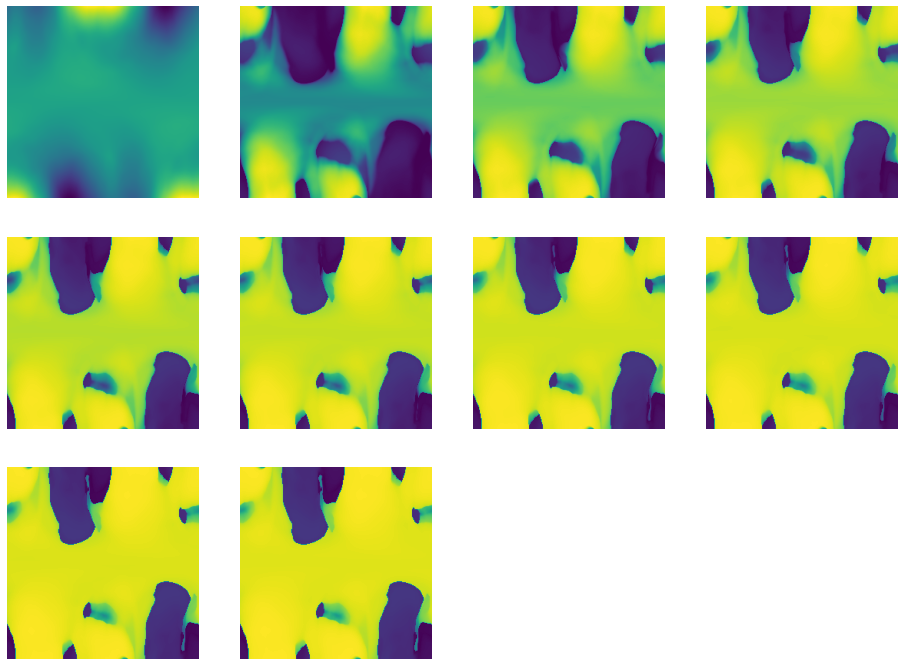

pair Layer 6:   0%|          | 0/100 [00:00<?, ?it/s]

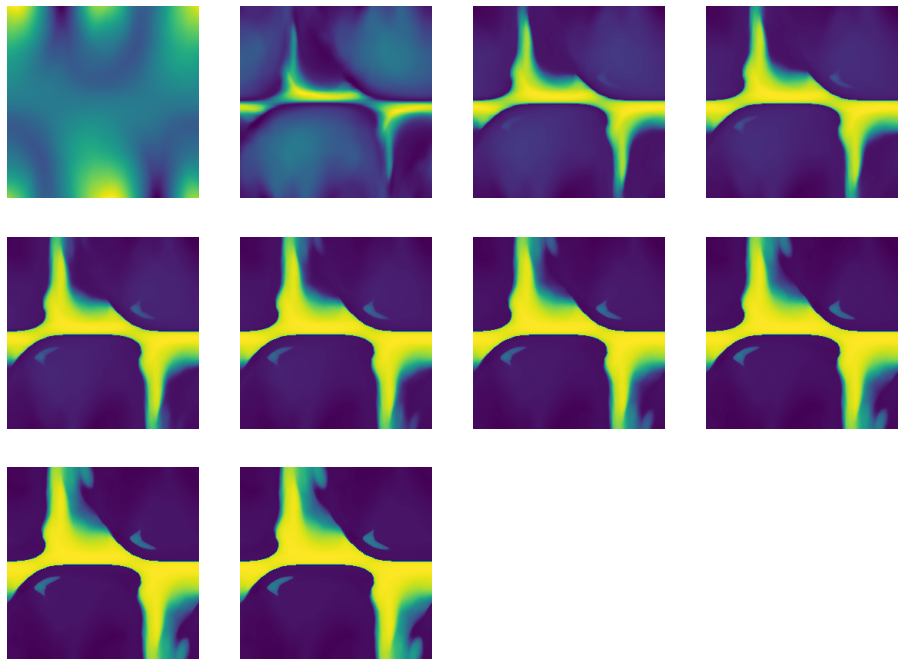

pair Layer 7:   0%|          | 0/100 [00:00<?, ?it/s]

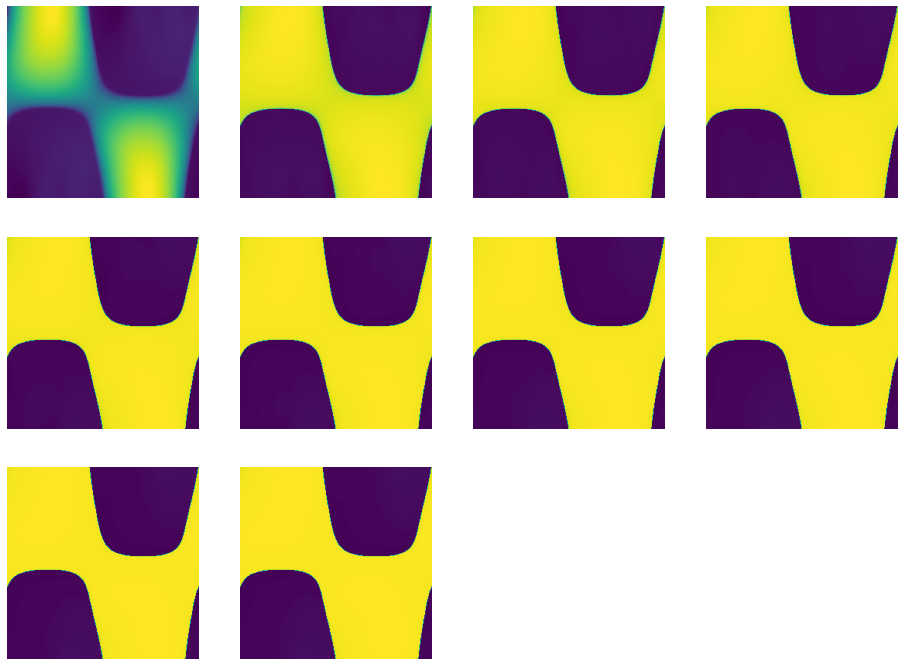

pair Layer 8:   0%|          | 0/100 [00:00<?, ?it/s]

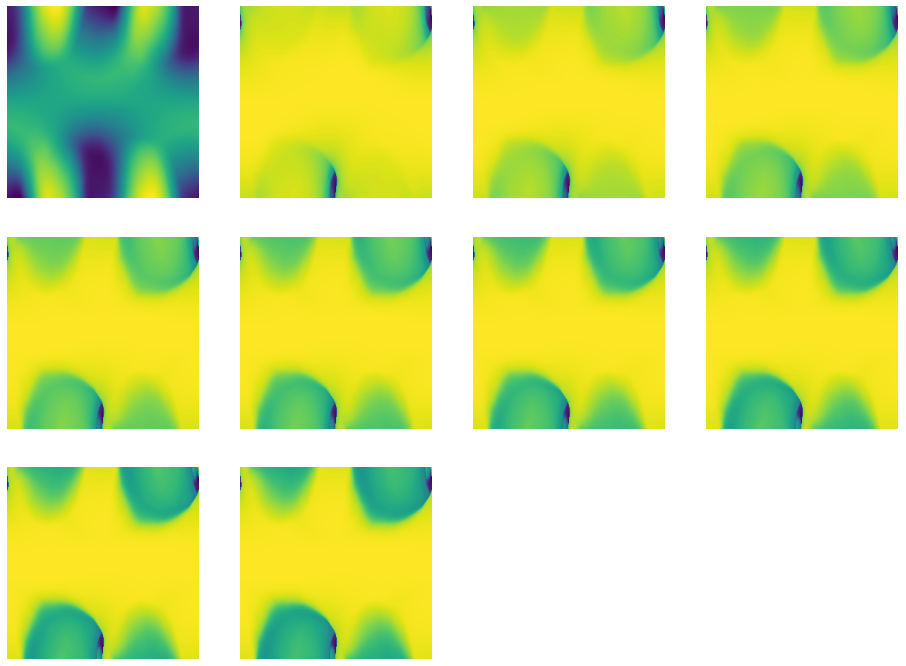

pair Layer 9:   0%|          | 0/100 [00:00<?, ?it/s]

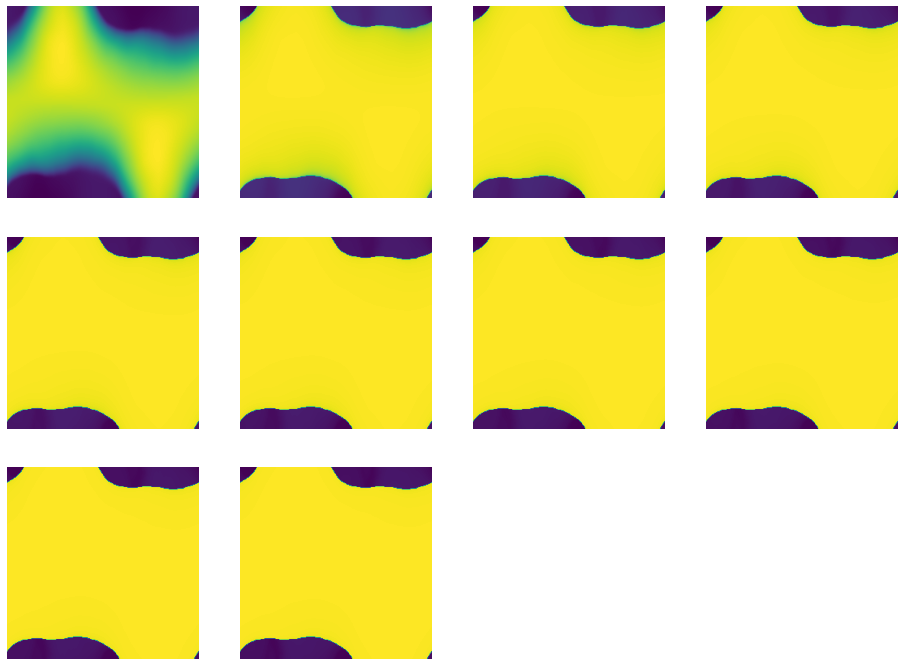

pair Layer 10:   0%|          | 0/100 [00:00<?, ?it/s]

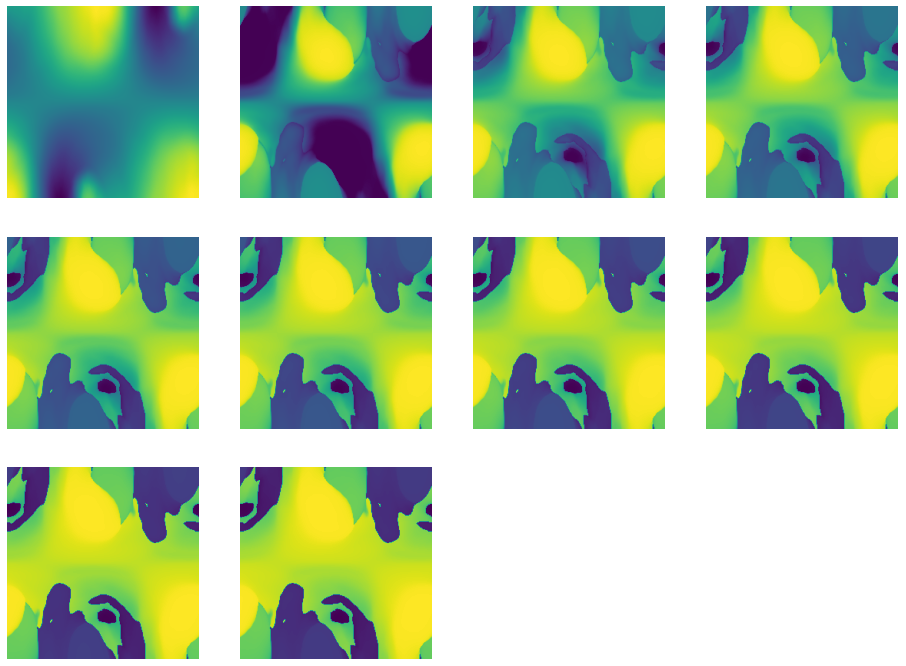

pair Layer 11:   0%|          | 0/100 [00:00<?, ?it/s]

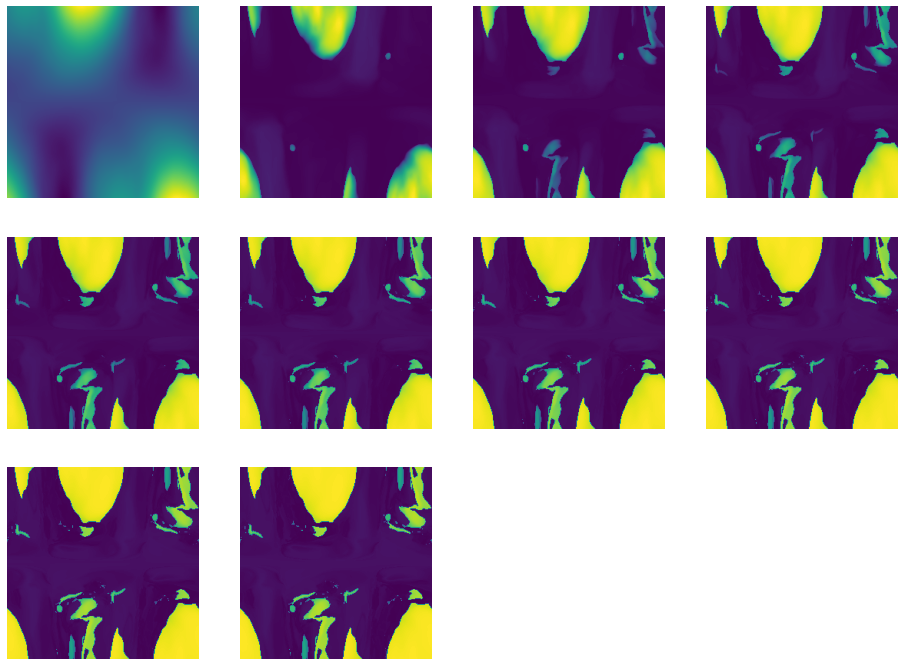

pair Layer 12:   0%|          | 0/100 [00:00<?, ?it/s]

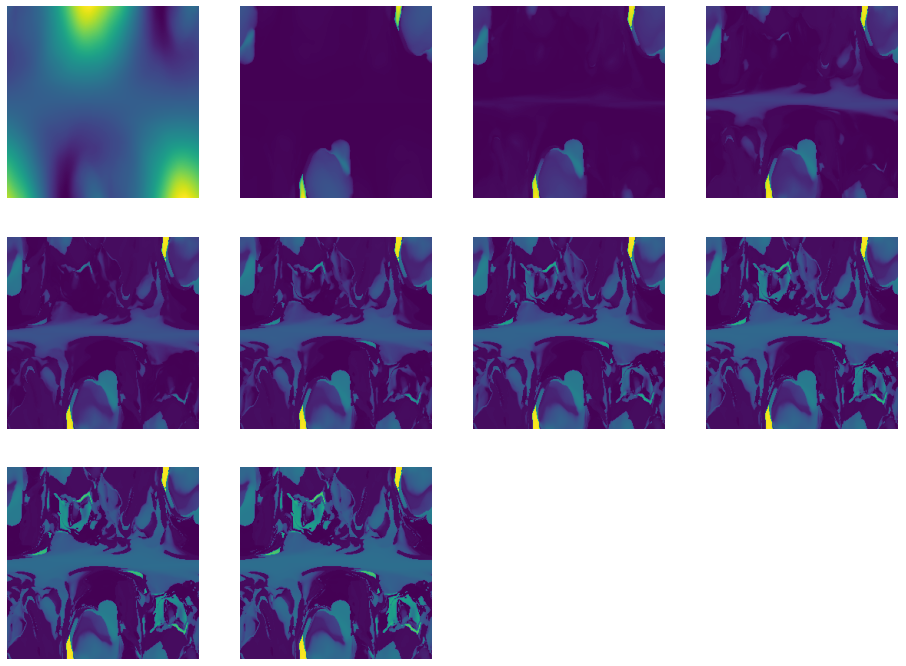

pair Layer 13:   0%|          | 0/100 [00:00<?, ?it/s]

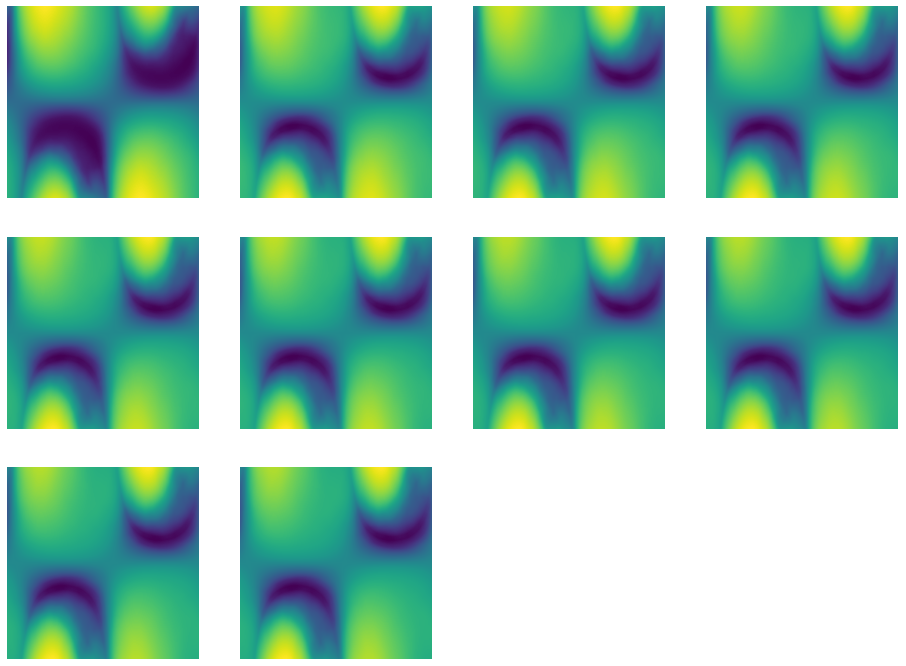

pair Layer 14:   0%|          | 0/100 [00:00<?, ?it/s]

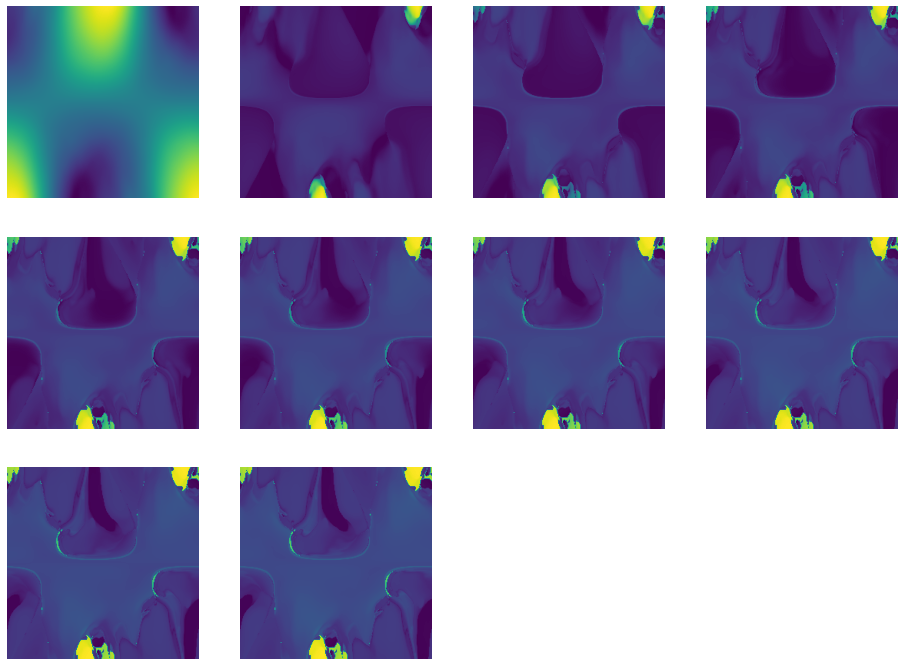

pair Layer 15:   0%|          | 0/100 [00:00<?, ?it/s]

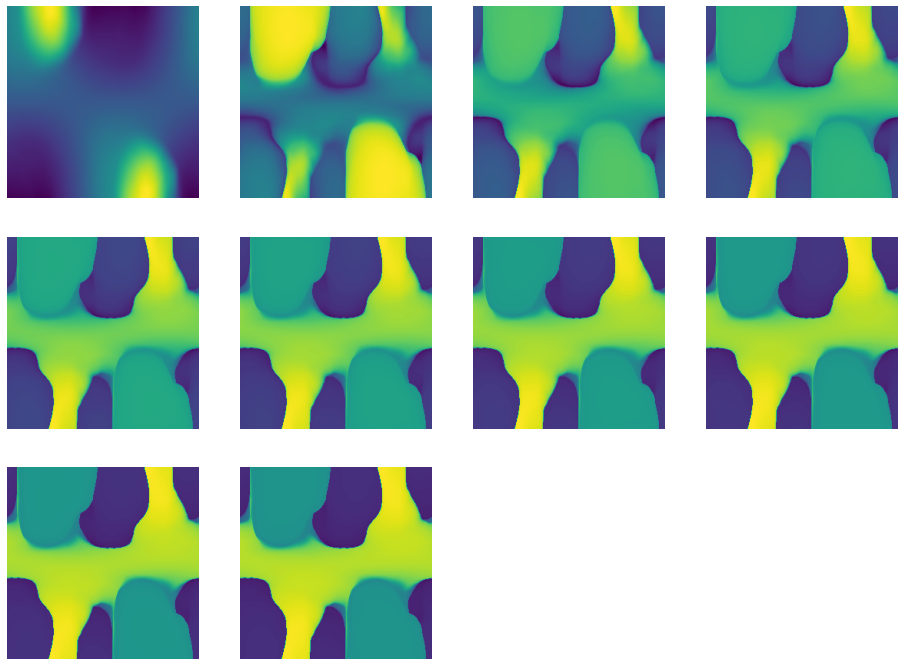

pair Layer 16:   0%|          | 0/100 [00:00<?, ?it/s]

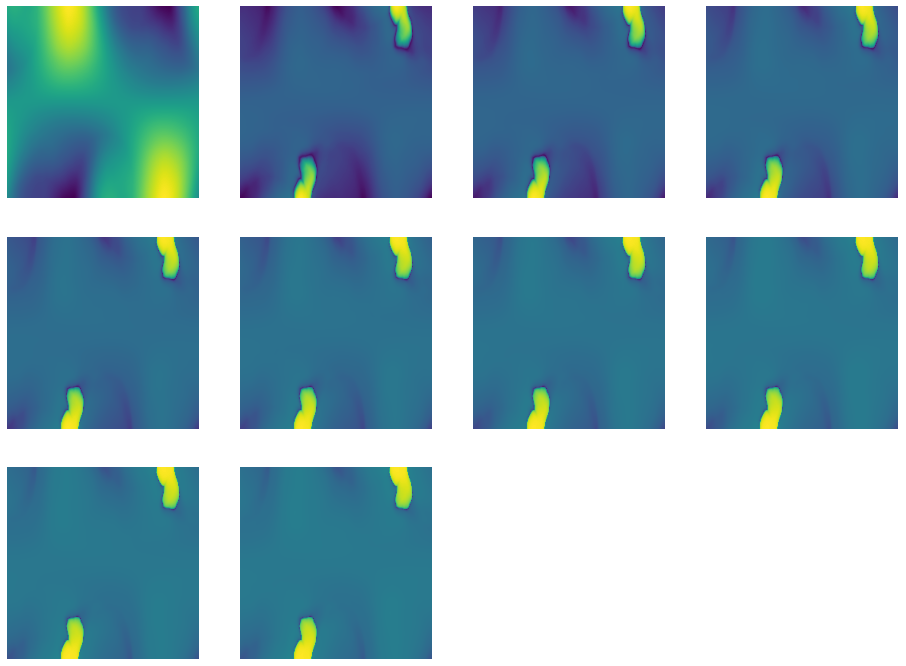

pair Layer 17:   0%|          | 0/100 [00:00<?, ?it/s]

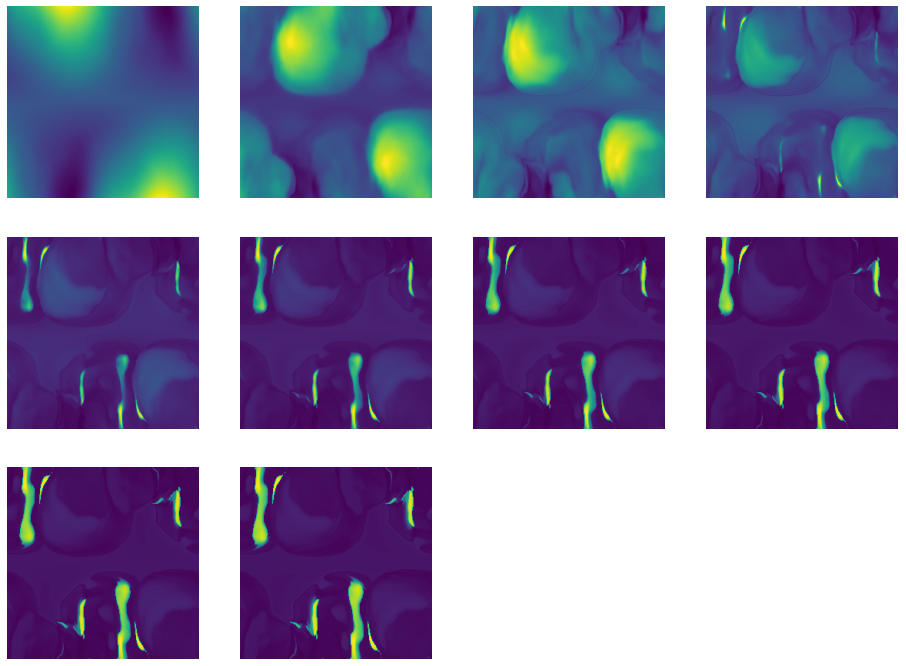

pair Layer 18:   0%|          | 0/100 [00:00<?, ?it/s]

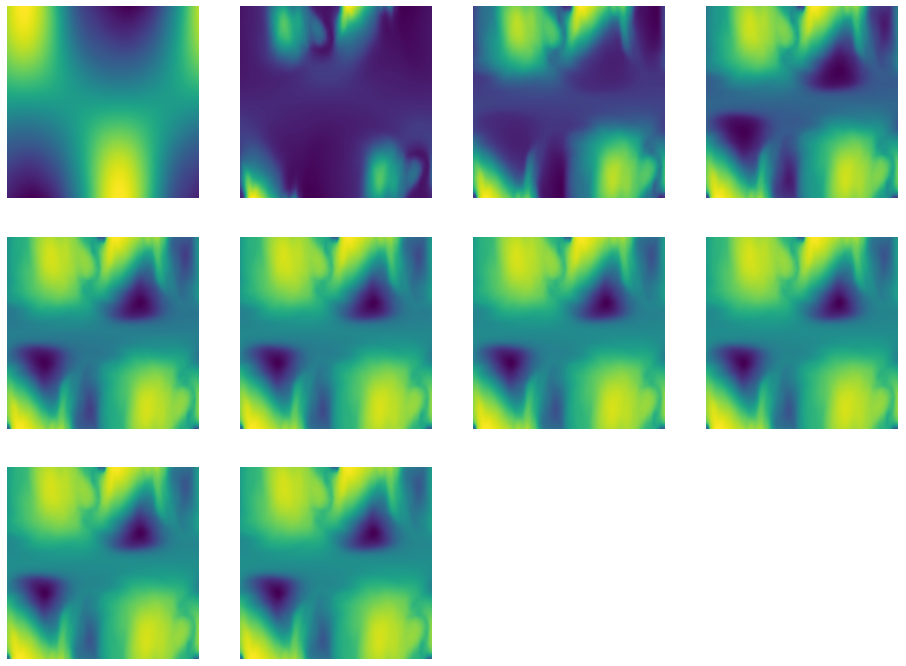

pair Layer 19:   0%|          | 0/100 [00:00<?, ?it/s]

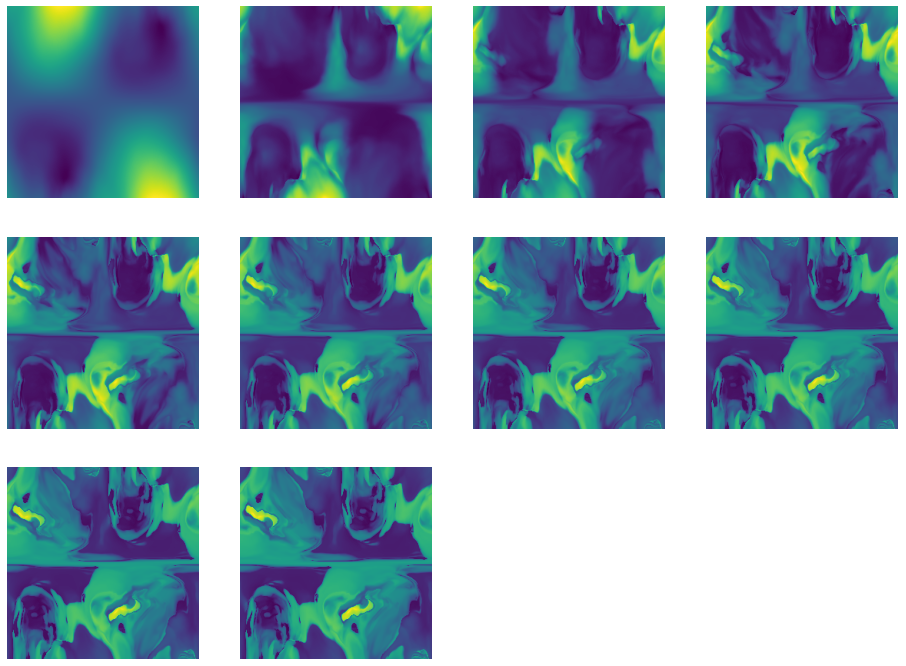

pair Layer 20:   0%|          | 0/100 [00:00<?, ?it/s]

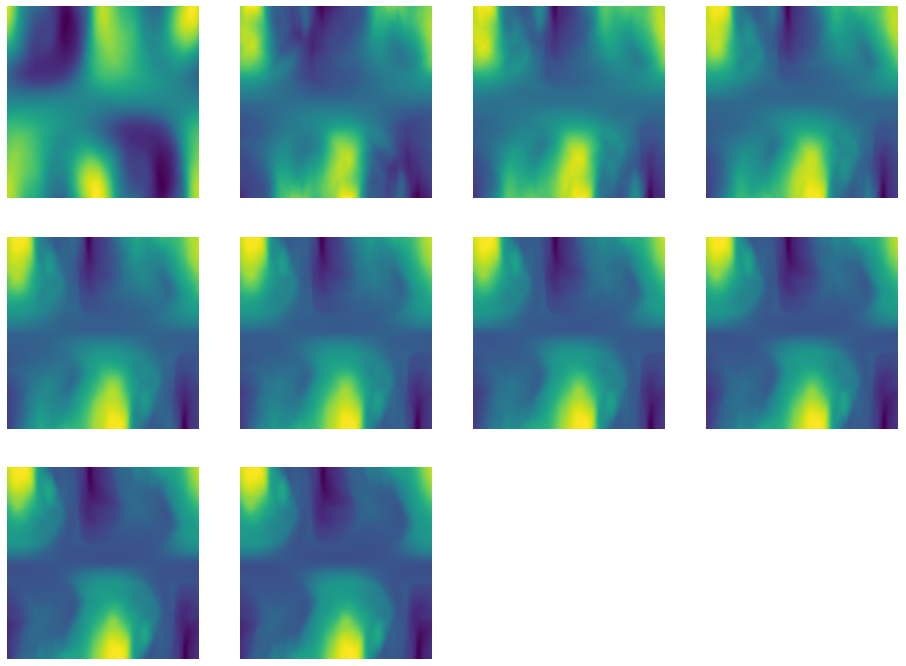

pair Layer 21:   0%|          | 0/100 [00:00<?, ?it/s]

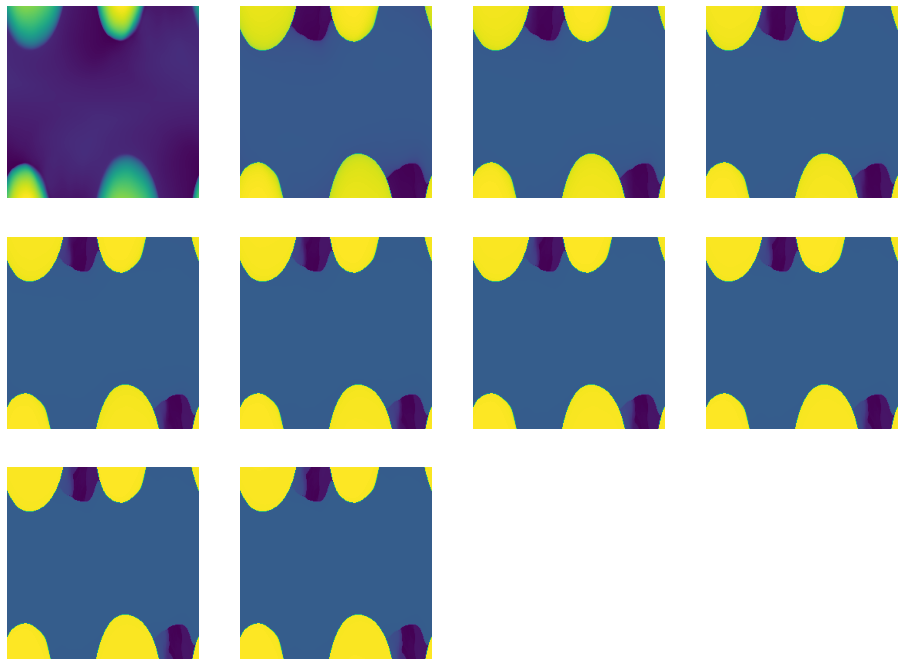

pair Layer 22:   0%|          | 0/100 [00:00<?, ?it/s]

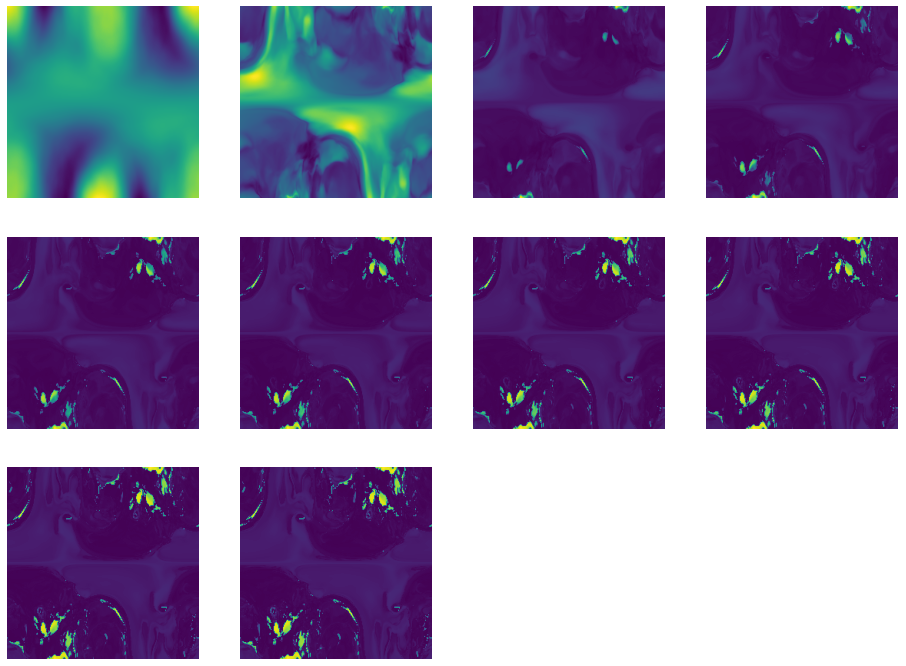

pair Layer 23:   0%|          | 0/100 [00:00<?, ?it/s]

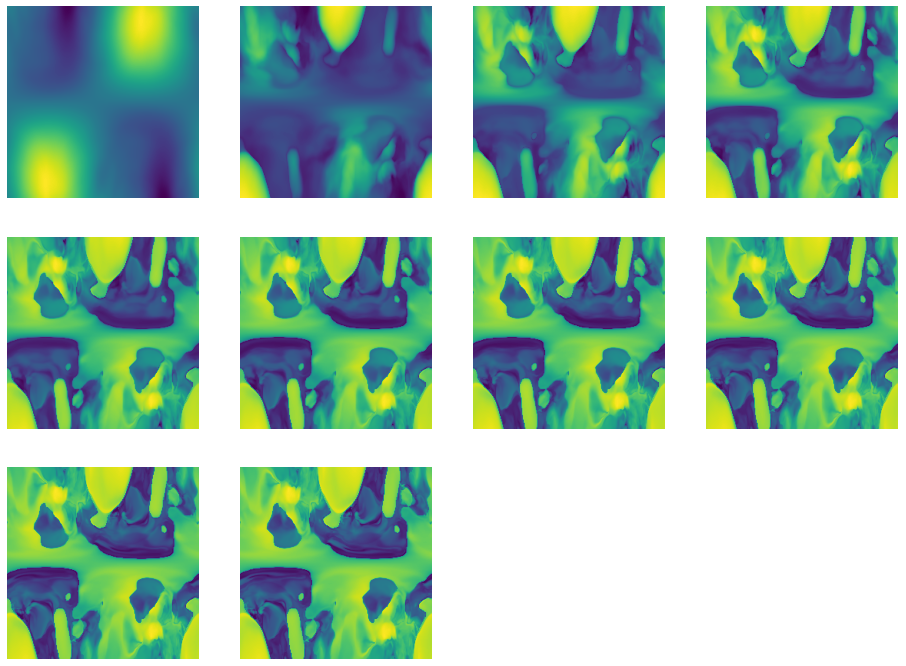

pair Layer 24:   0%|          | 0/100 [00:00<?, ?it/s]

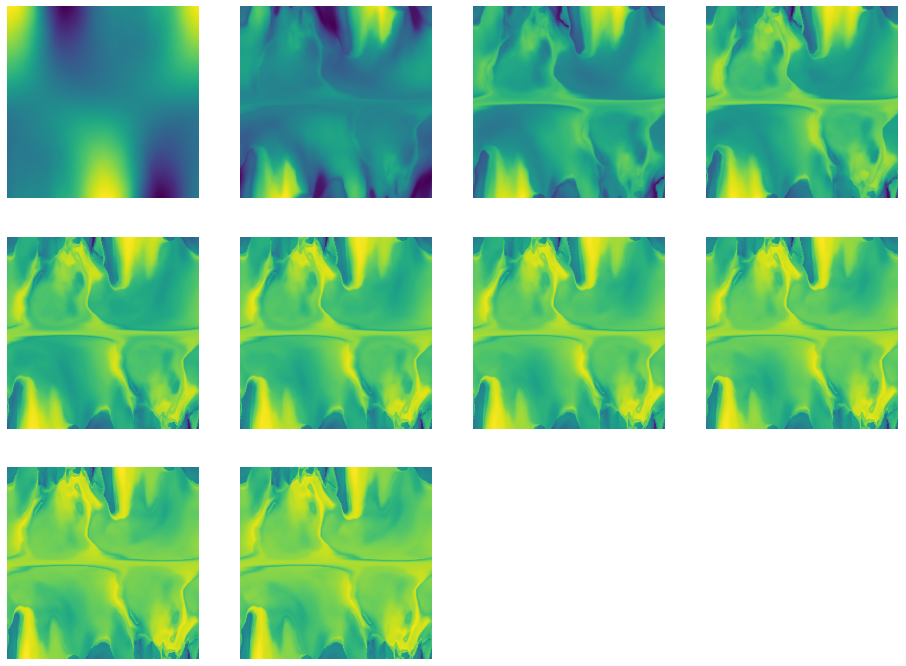

pair Layer 25:   0%|          | 0/100 [00:00<?, ?it/s]

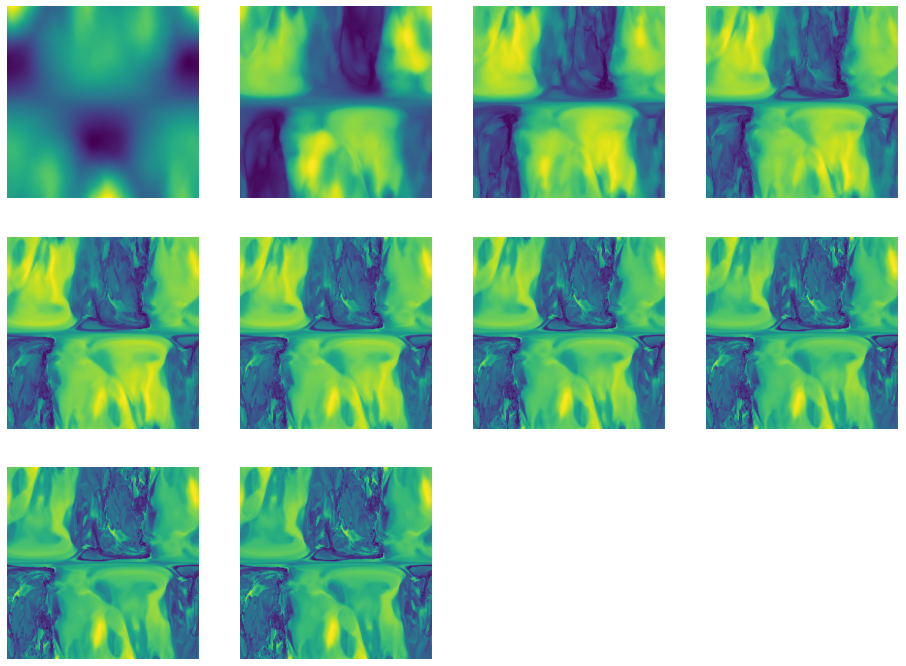

pair Layer 26:   0%|          | 0/100 [00:00<?, ?it/s]

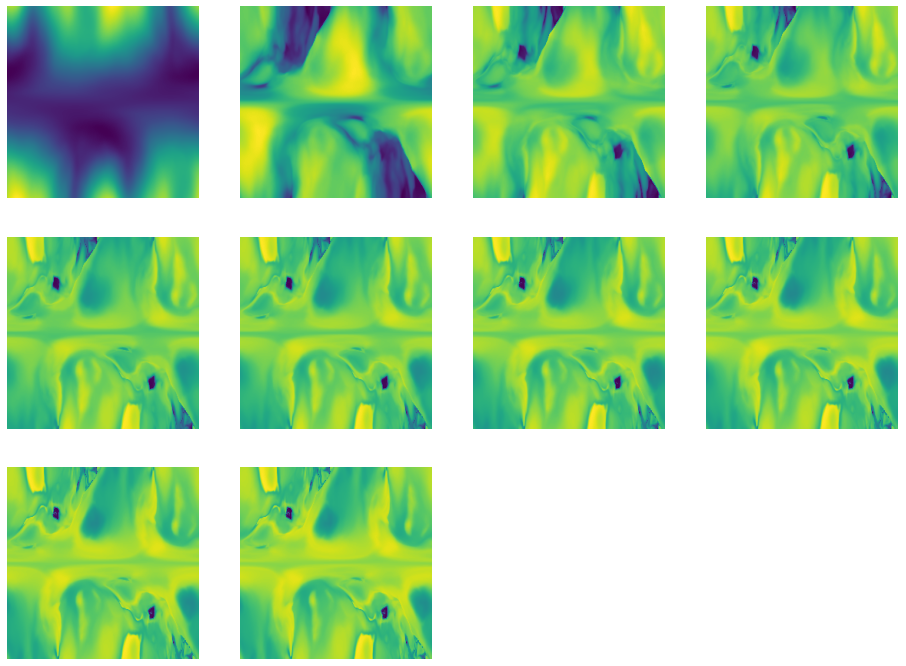

pair Layer 27:   0%|          | 0/100 [00:00<?, ?it/s]

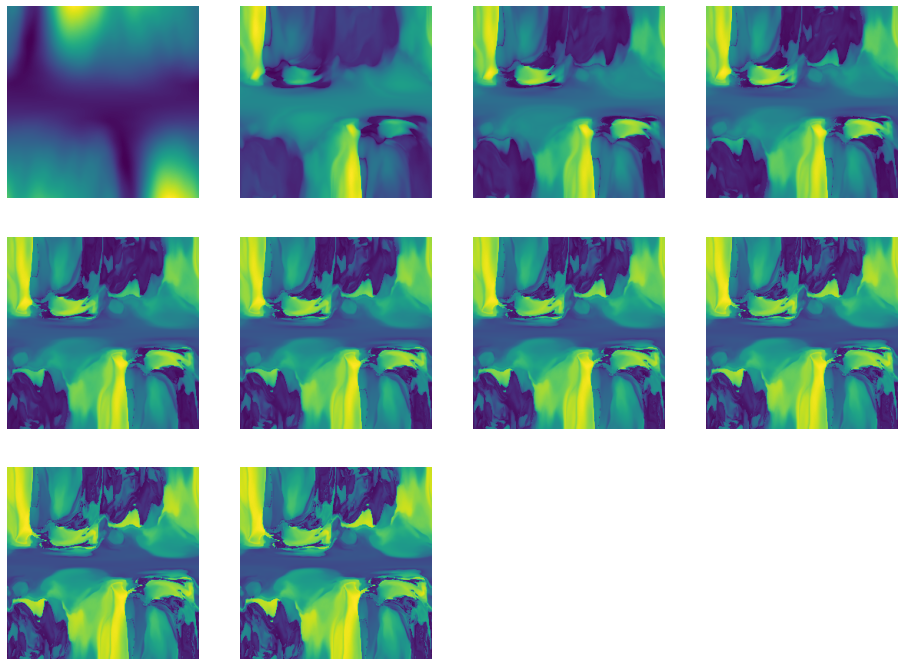

pair Layer 28:   0%|          | 0/100 [00:00<?, ?it/s]

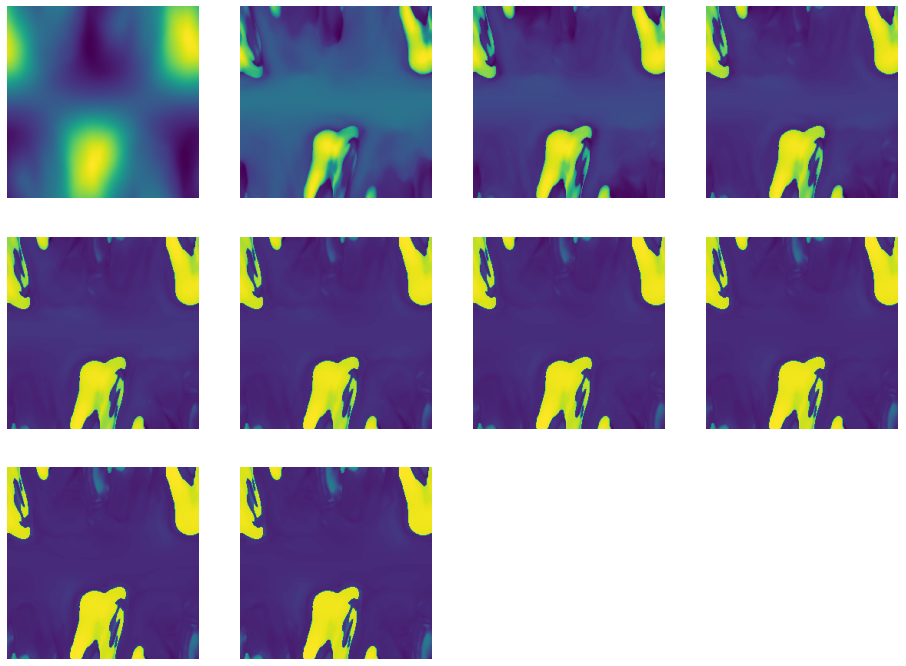

pair Layer 29:   0%|          | 0/100 [00:00<?, ?it/s]

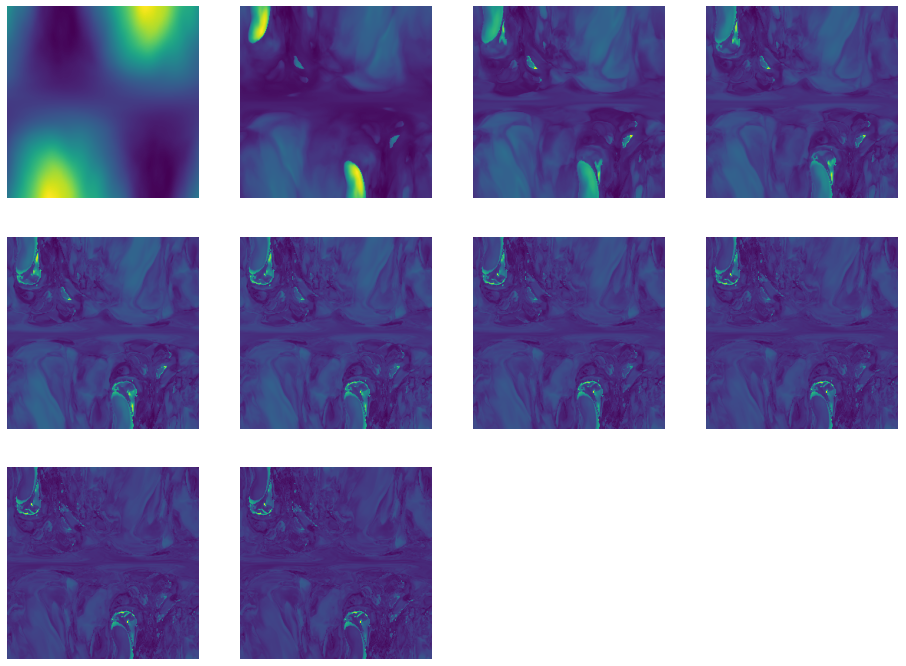

pair Layer 30:   0%|          | 0/100 [00:00<?, ?it/s]

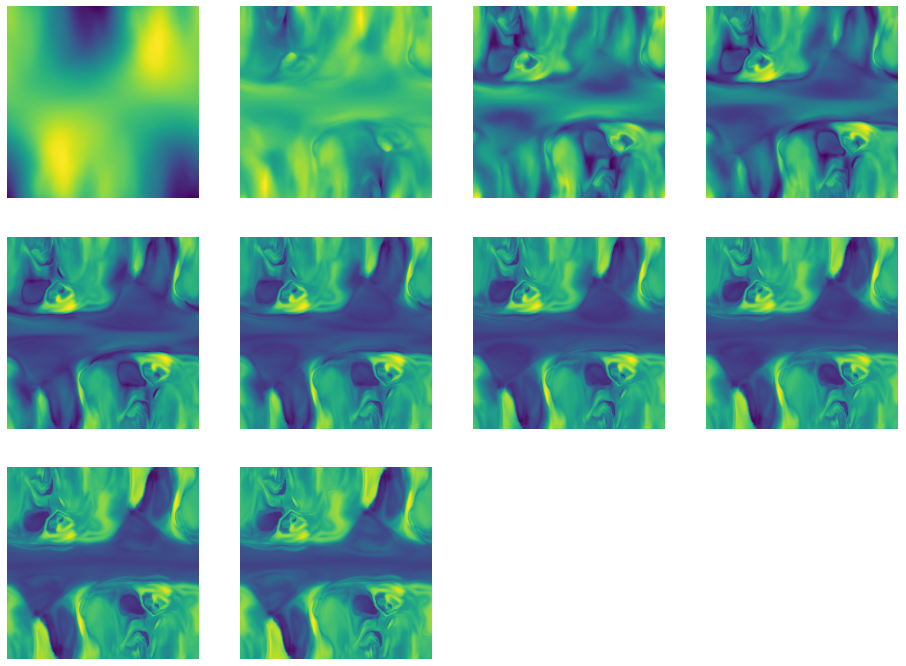

pair Layer 31:   0%|          | 0/100 [00:00<?, ?it/s]

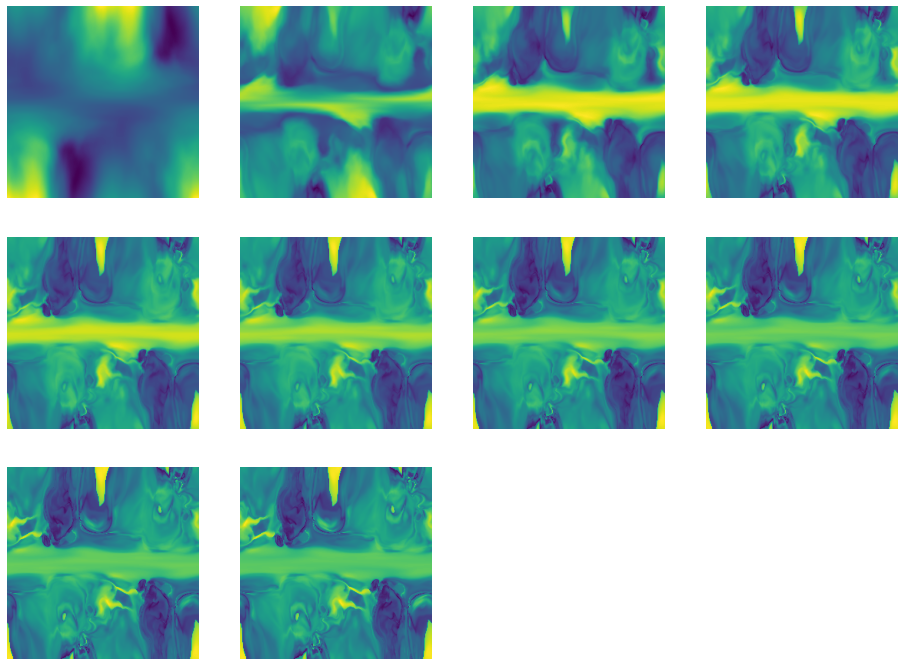

pair Layer 32:   0%|          | 0/100 [00:00<?, ?it/s]

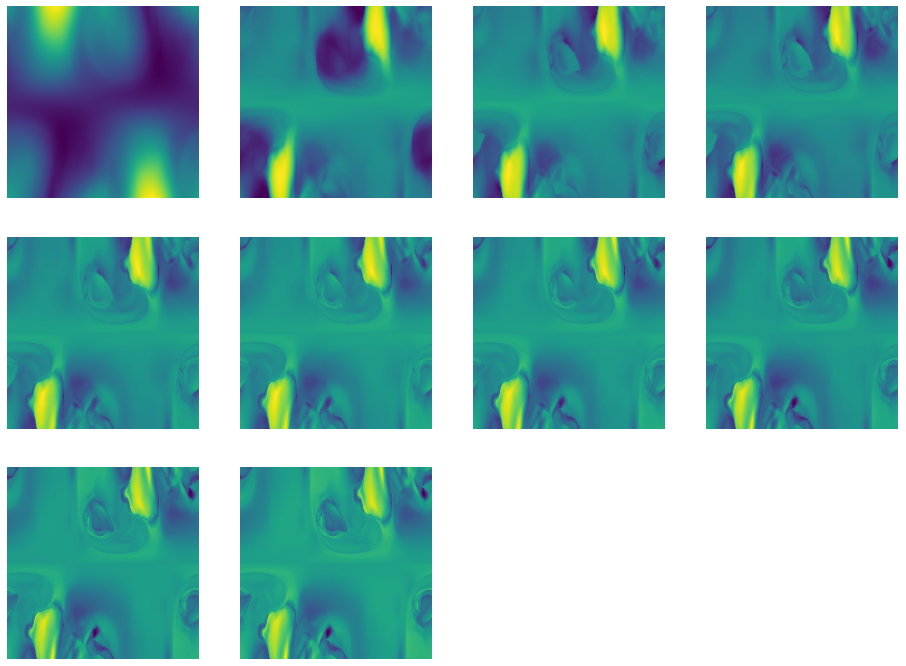

pair Layer 33:   0%|          | 0/100 [00:00<?, ?it/s]

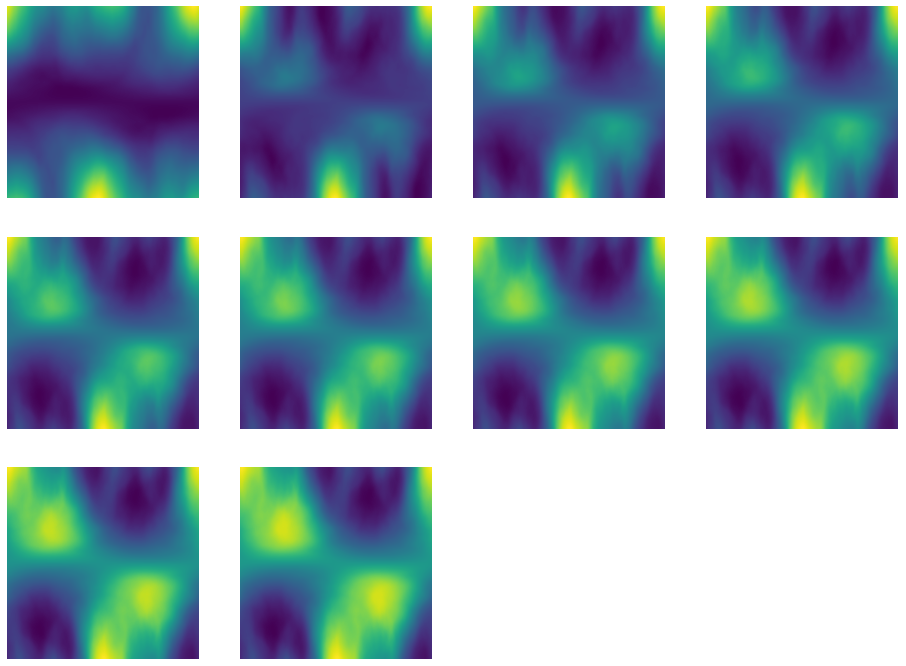

pair Layer 34:   0%|          | 0/100 [00:00<?, ?it/s]

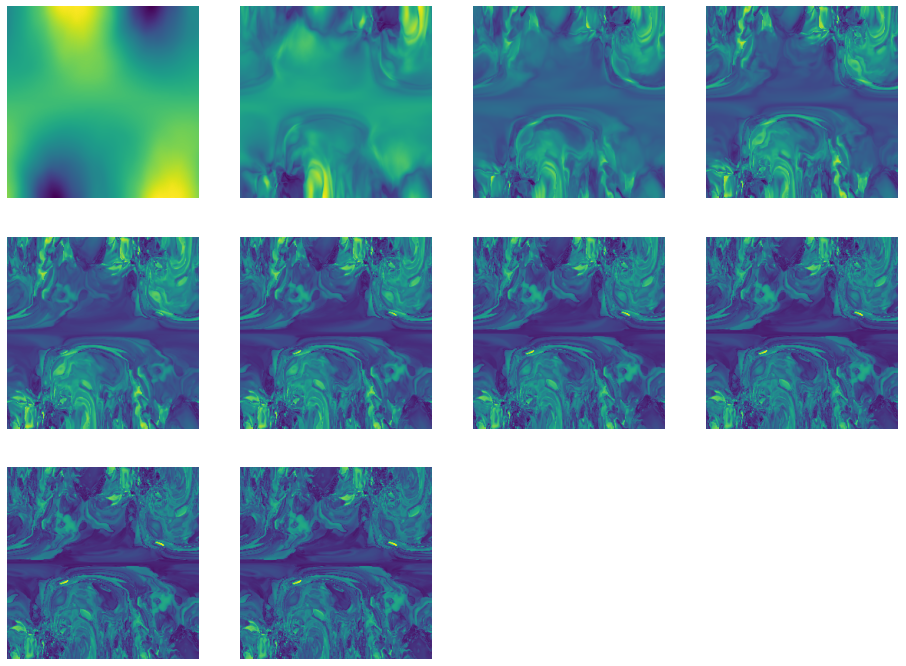

pair Layer 35:   0%|          | 0/100 [00:00<?, ?it/s]

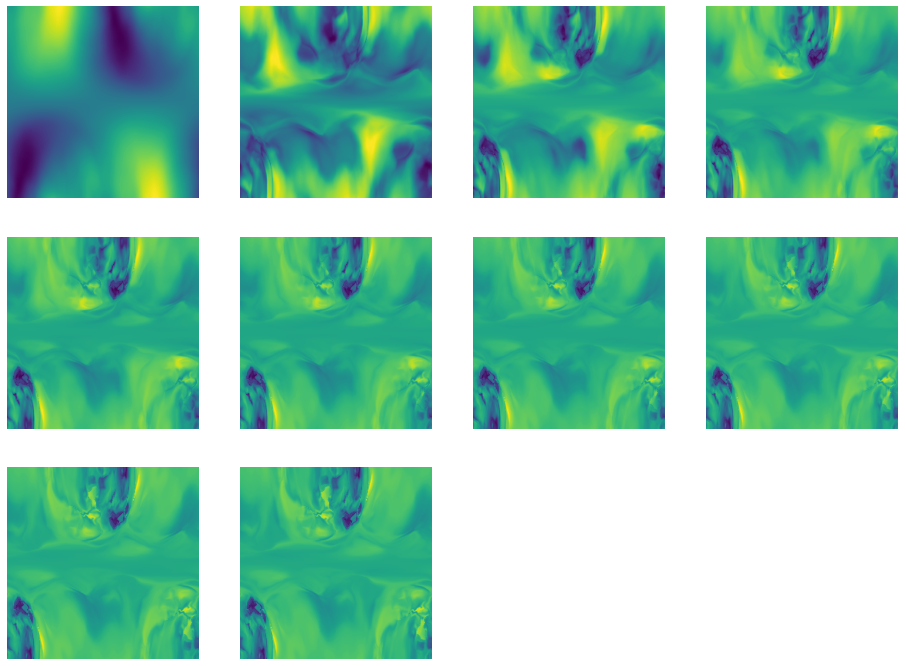

pair Layer 36:   0%|          | 0/100 [00:00<?, ?it/s]

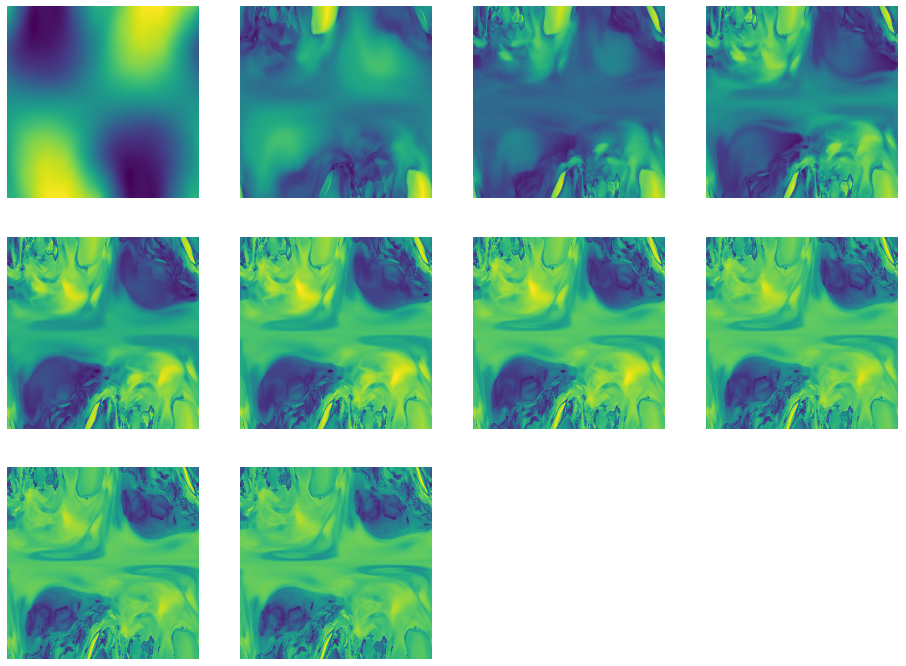

pair Layer 37:   0%|          | 0/100 [00:00<?, ?it/s]

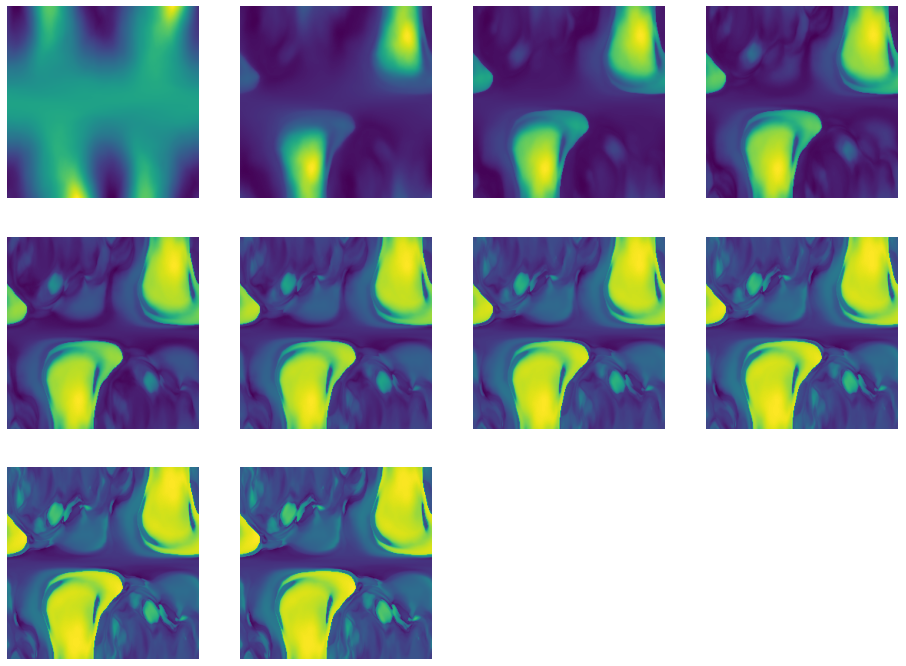

pair Layer 38:   0%|          | 0/100 [00:00<?, ?it/s]

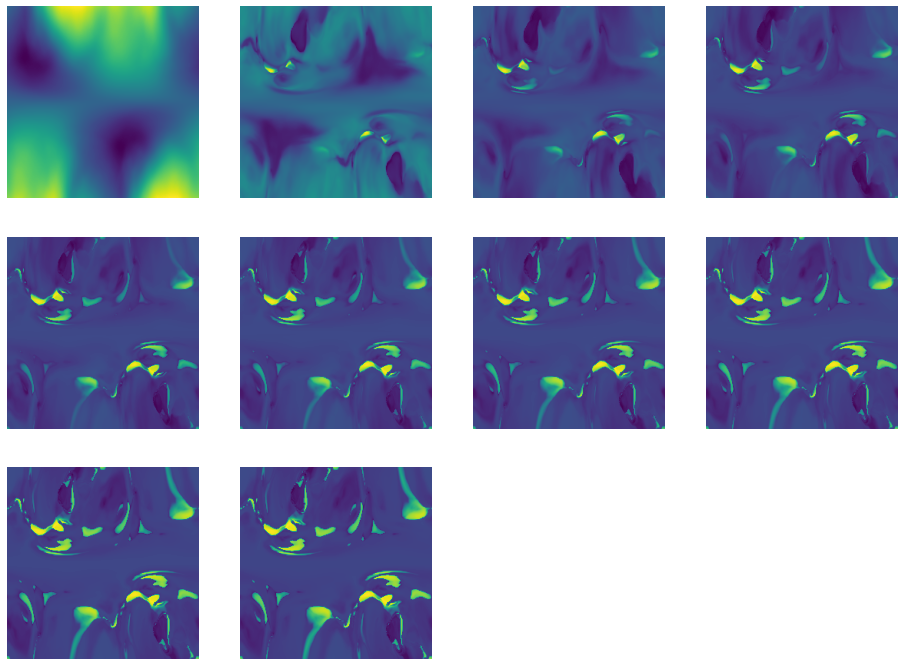

pair Layer 39:   0%|          | 0/100 [00:00<?, ?it/s]

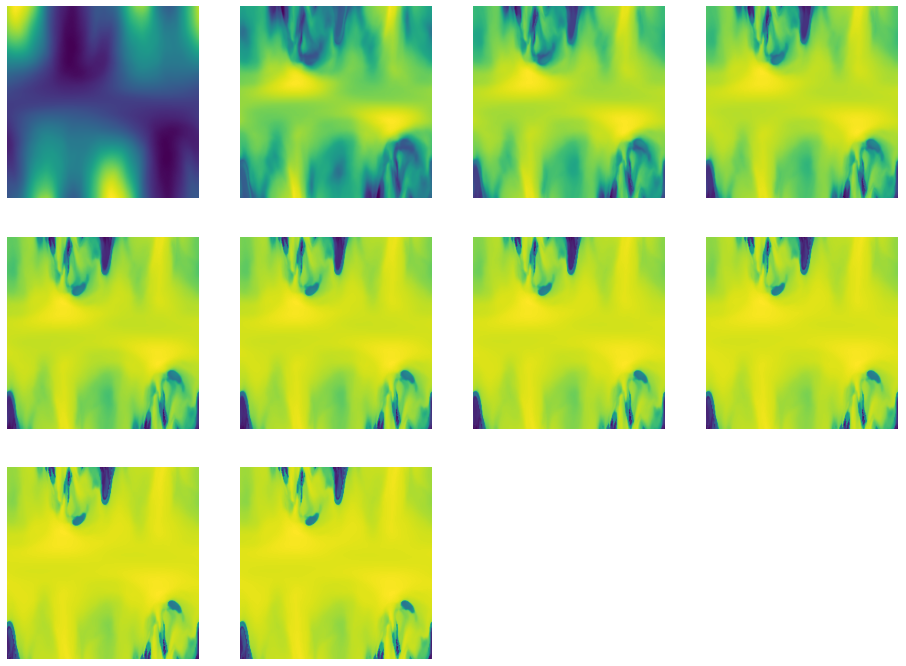

pair Layer 40:   0%|          | 0/100 [00:00<?, ?it/s]

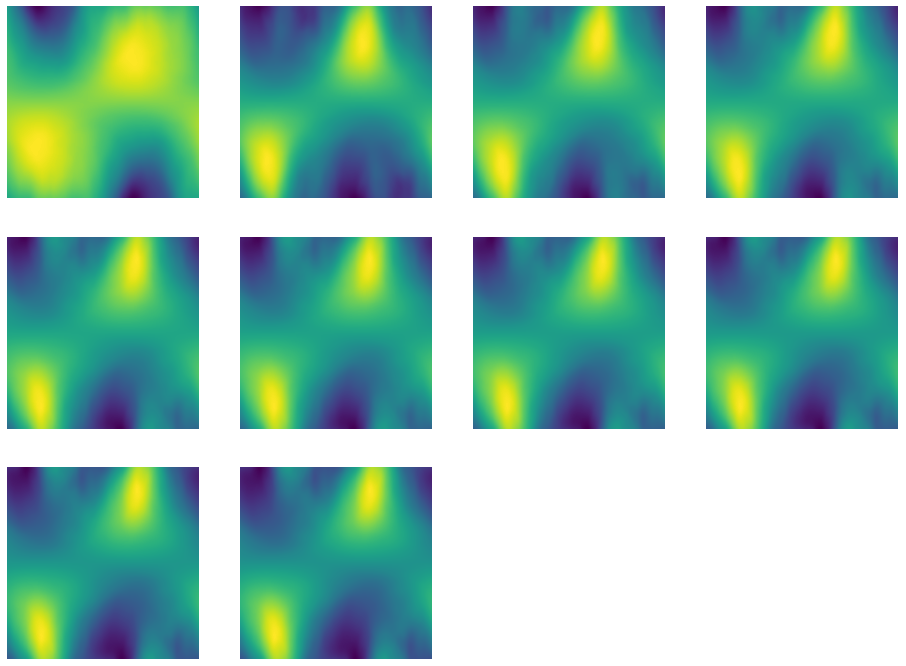

pair Layer 41:   0%|          | 0/100 [00:00<?, ?it/s]

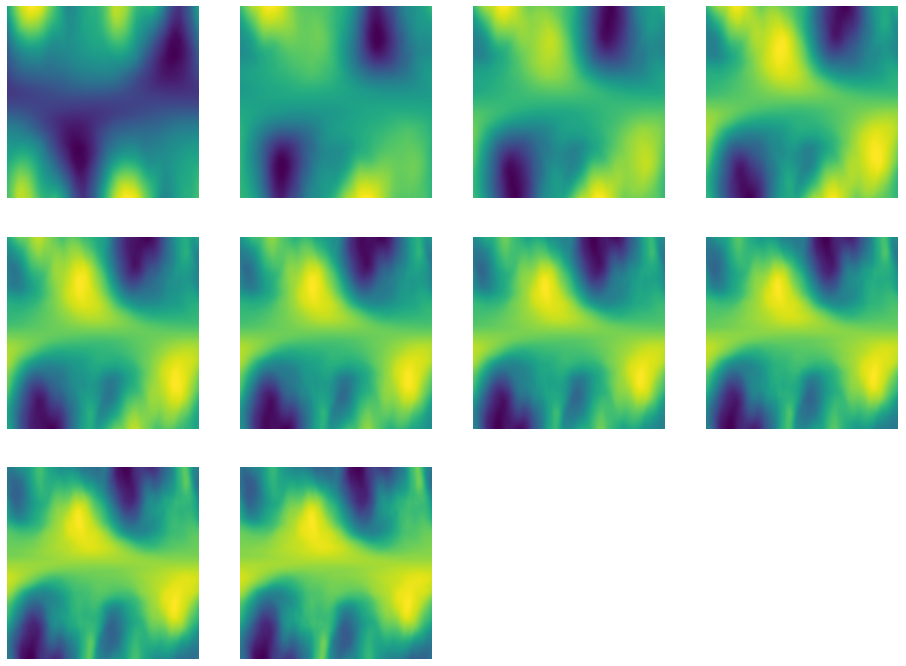

pair Layer 42:   0%|          | 0/100 [00:00<?, ?it/s]

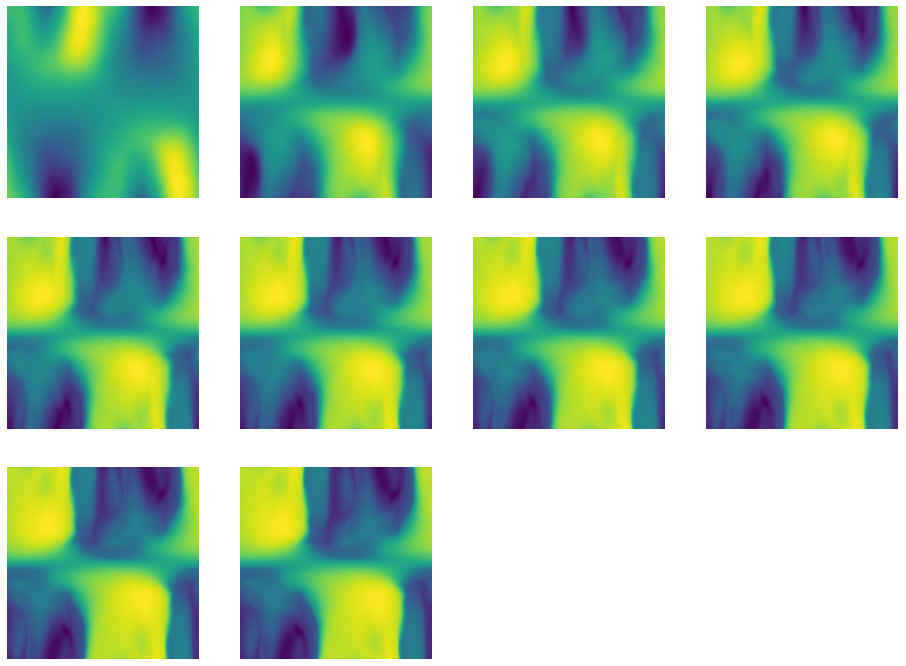

pair Layer 43:   0%|          | 0/100 [00:00<?, ?it/s]

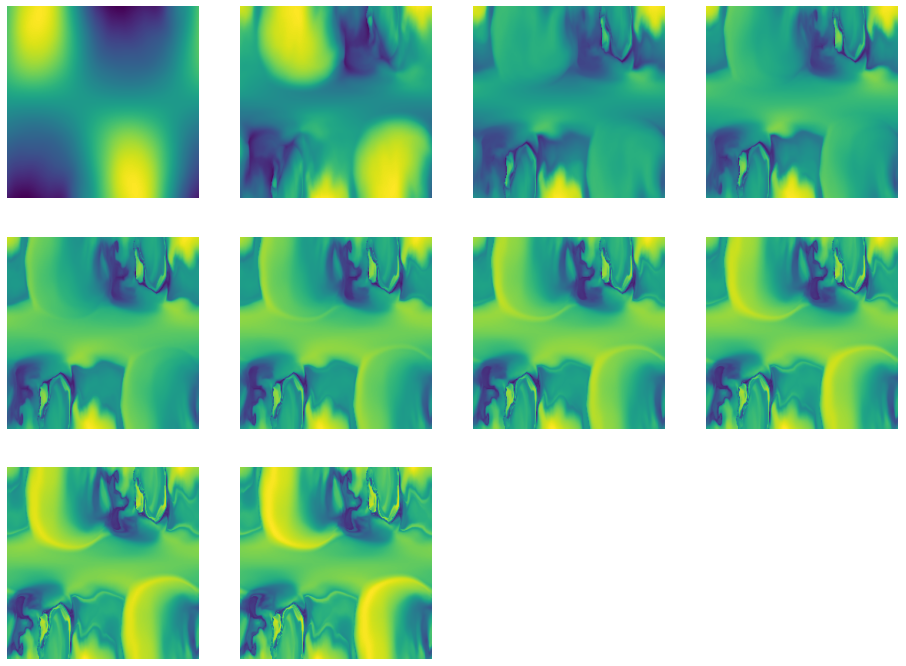

pair Layer 44:   0%|          | 0/100 [00:00<?, ?it/s]

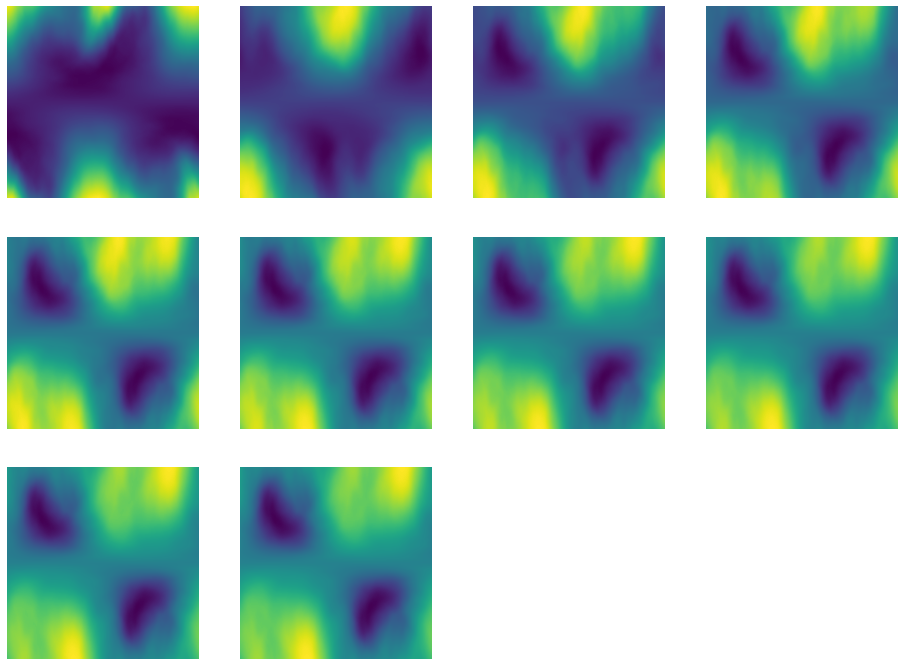

pair Layer 45:   0%|          | 0/100 [00:00<?, ?it/s]

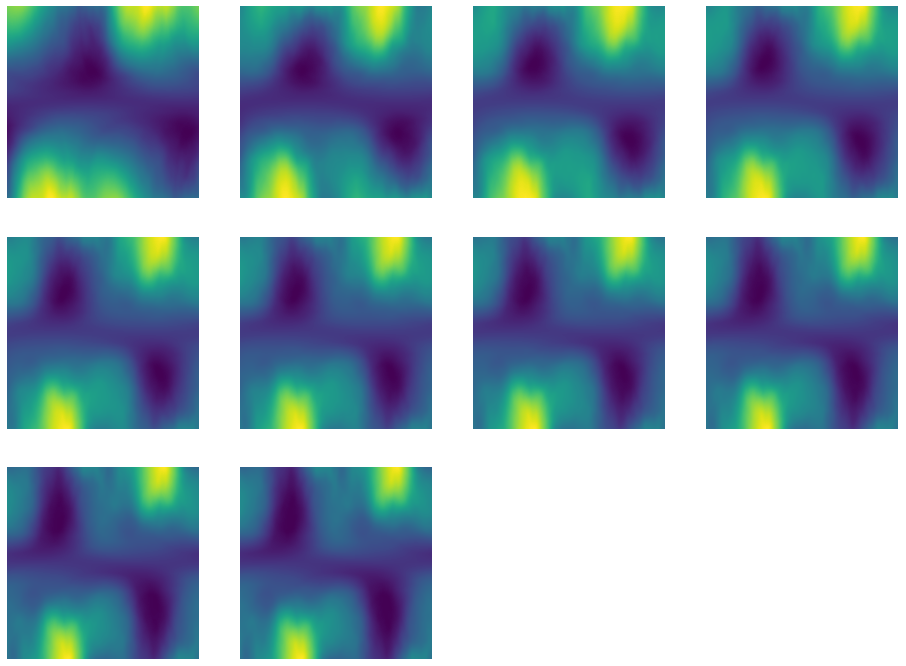

pair Layer 46:   0%|          | 0/100 [00:00<?, ?it/s]

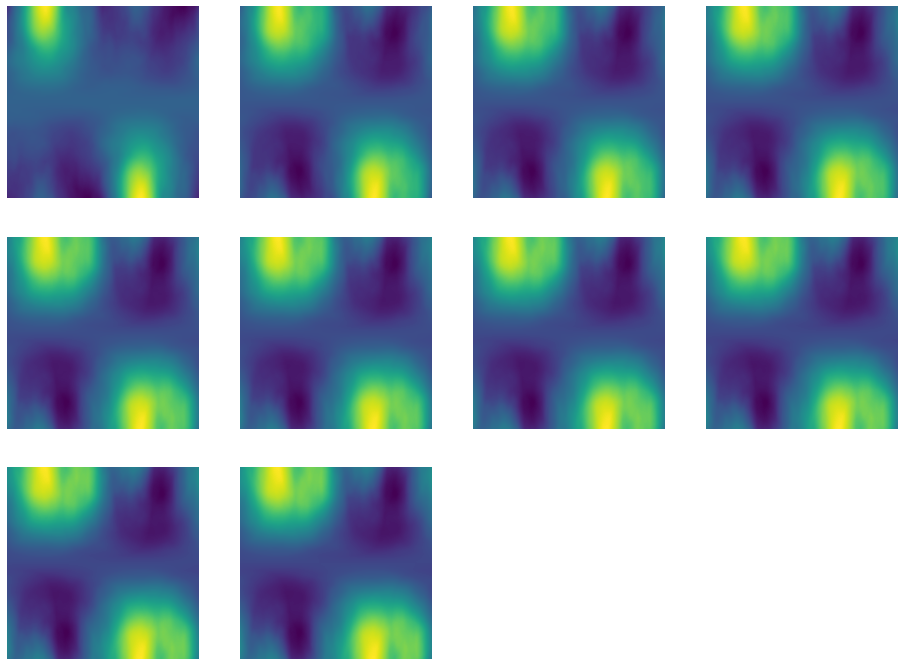

pair Layer 47:   0%|          | 0/100 [00:00<?, ?it/s]

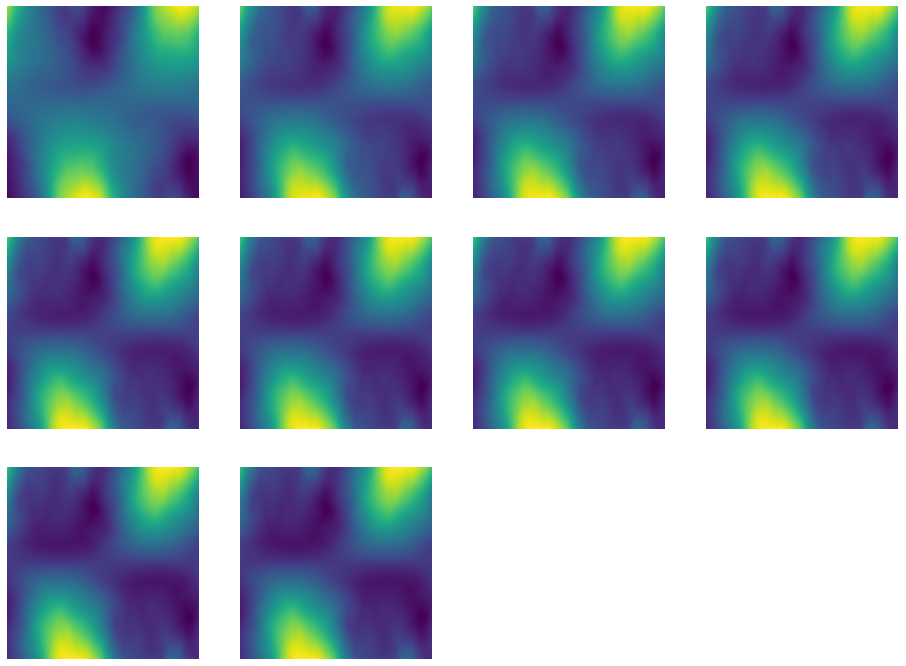

In [273]:
#pair_str = "msa"
#layer_id = 27

n_iters = 10
dims = 2
n_samples = 250
iter_steps = 100
plot_skip = 10
cols = 4
inches = 4

for pair_str in ["msa", "pair"]:
    for layer_id in range(0, 48):
        param_basename = F'alphafold/alphafold_iteration/evoformer/evoformer_iteration/{pair_str}_transition/'
        trans_param_keys = ['input_layer_norm', 'transition1', 'transition2']
        param_names = [param_basename + k for k in trans_param_keys]

        block_name = F"{pair_str}_transition/"
        block_param_names = [block_name + k for k in trans_param_keys]

        msa_trans_cfg = cfg.model.embeddings_and_evoformer.evoformer.msa_transition
        pair_trans_cfg = cfg.model.embeddings_and_evoformer.evoformer.pair_transition
        global_cfg = cfg.model.global_config

        c_pair = cfg.model.embeddings_and_evoformer.pair_channel
        c_msa = cfg.model.embeddings_and_evoformer.msa_channel

        c = c_msa if pair_str == "msa" else c_pair
        trans_cfg = msa_trans_cfg if pair_str == "msa" else msa_trans_cfg

        def l2norm(x):
            return jnp.linalg.norm(x, axis=-1)

        out_fn = l2norm

        def _forward_fn(batch):
            transition_model = model.modules.Transition(trans_cfg, global_cfg, name=block_name[:-1])
            mask = jnp.zeros(0)

            #outputs = [out_fn(batch)]
            for i in range(n_iters):
                output = transition_model(
                    batch,
                    mask=mask,
                    is_training=False
                )
                batch += output
                #outputs.append(out_fn(output))
            #return jnp.stack(outputs)
            return batch

        apply_fn = jax.jit(hk.transform(_forward_fn).apply)
        init_fn = jax.jit(hk.transform(_forward_fn).init)

        rng = jax.random.PRNGKey(0)
        layer_params = hk.data_structures.to_mutable_dict(init_fn(rng, jnp.zeros((10000, 1, c))))
        for b, p in zip(block_param_names, param_names):
            pdict = {}
            for k, v in params[p].items():
                pdict[k] = v[layer_id]
            layer_params[b] = pdict


        pca = PCA(dims+1).fit(layer_params[block_param_names[1]]["weights"].T)
        components = pca.components_

        def from_spherical(angle_grid, r):
            return jnp.stack([
                r * jnp.cos(angle_grid[...,0]) * jnp.sin(angle_grid[...,1]),
                r * jnp.sin(angle_grid[...,0]) * jnp.sin(angle_grid[...,1]),
                r * jnp.cos(angle_grid[..., 1])
            ], axis=-1)

        def to_spherical(xyz):
            return jnp.stack([
                jnp.atan2(xyz[...,1], xyz[...,0]),
                jnp.atan2(jnp.linalg.norm(xyz[...,:2], axis=-1), xyz[...,2]),
                jnp.linalg.norm(xyz, axis=-1)
            ], axis=-1)

        def get_grid_ns(n: int = 300, dims: int = dims, sizes = (-1.0, 1.0)):
            if type(n) is int:
                n = [n] * dims
            if type(sizes[0]) in [float, int]:
                sizes = [sizes] * dims

            steps = [jnp.linspace(sizes[i][0], sizes[i][1], n[i]) for i in range(dims)]
            return jnp.stack(jnp.meshgrid(*steps), axis=-1)

        # unfirom points on a sphere
        grid = get_grid_ns(
            n=n_samples, 
            dims=dims, 
            sizes=[(-np.pi, np.pi), (-1, 1)]
        )
        jax.ops.index_update(grid, jax.ops.index[...,1], jnp.arccos(grid[...,1]))
        #grid[...,1] = jnp.arccos(grid[...,1])
        grid = from_spherical(grid, r=30.0)
        _input = grid.reshape(-1, dims + 1)

        proj = jnp.matmul(_input, components)
        proj = jnp.expand_dims(proj, -2)

        steps = []
        for i in tqdm.notebook.tqdm(range(iter_steps), F"{pair_str} Layer {layer_id}"):
            proj = apply_fn(layer_params, rng, proj)
            steps.append(l2norm(proj))
        steps = jnp.stack(steps)

        grids_out = steps.reshape(steps.shape[0], n_samples, n_samples, steps.shape[-1])


        count = grids_out.shape[0] // plot_skip

        import math
        rows = int(math.ceil(count/cols))
        fig, ax = plt.subplots(count // cols + 1, cols, figsize=(inches*cols, inches*rows))
        for i in range(0, cols*rows):
            if i < count:
                ax[i//cols,i%cols].imshow(grids_out[i*plot_skip].squeeze())
            ax[i//cols,i%cols].axis('off')
        plt.show()

resolution_factor:
<0 = manual
0 = 135
1 = 270
2 = 540
3 = 1080p
4 = 4k
5 = 8k
6 = 16k
7 = 32k

In [5]:
resolution_factor = 7

pair_str = "pair"
layer_id = 29

n_iters = 1000
dims = 2
n_samples = 300
batch_size = 100
iter_steps = 1
plot_skip = 10
cols = 4
inches = 4

if resolution_factor >= 0:
    n_samples = 135 * np.power(2, resolution_factor)
    n_samples = int(round(n_samples/2)*2)

param_basename = F'alphafold/alphafold_iteration/evoformer/evoformer_iteration/{pair_str}_transition/'
trans_param_keys = ['input_layer_norm', 'transition1', 'transition2']
param_names = [param_basename + k for k in trans_param_keys]

block_name = F"{pair_str}_transition/"
block_param_names = [block_name + k for k in trans_param_keys]

msa_trans_cfg = cfg.model.embeddings_and_evoformer.evoformer.msa_transition
pair_trans_cfg = cfg.model.embeddings_and_evoformer.evoformer.pair_transition
global_cfg = cfg.model.global_config

c_pair = cfg.model.embeddings_and_evoformer.pair_channel
c_msa = cfg.model.embeddings_and_evoformer.msa_channel

c = c_msa if pair_str == "msa" else c_pair
trans_cfg = msa_trans_cfg if pair_str == "msa" else msa_trans_cfg

def l2norm(x):
    return jnp.linalg.norm(x, axis=-1)

out_fn = l2norm

def _forward_fn(batch):
    transition_model = model.modules.Transition(trans_cfg, global_cfg, name=block_name[:-1])
    mask = jnp.zeros(0)

    #outputs = [out_fn(batch)]
    for i in range(n_iters):
        output = transition_model(
            batch,
            mask=mask,
            is_training=False
        )
        batch += output
        #outputs.append(out_fn(output))
    #return jnp.stack(outputs)
    return batch

apply_fn = jax.jit(hk.transform(_forward_fn).apply)
init_fn = jax.jit(hk.transform(_forward_fn).init)

rng = jax.random.PRNGKey(0)
layer_params = hk.data_structures.to_mutable_dict(init_fn(rng, jnp.zeros((1, 1, c))))
for b, p in zip(block_param_names, param_names):
    pdict = {}
    for k, v in params[p].items():
        pdict[k] = v[layer_id]
    layer_params[b] = pdict


pca = PCA(dims+1).fit(layer_params[block_param_names[1]]["weights"].T)
components = jax.device_put(pca.components_)

def from_spherical(angle_grid, r):
    return np.stack([
        r * np.cos(angle_grid[...,0]) * np.sin(angle_grid[...,1]),
        r * np.sin(angle_grid[...,0]) * np.sin(angle_grid[...,1]),
        r * np.cos(angle_grid[..., 1])
    ], axis=-1)

def to_spherical(xyz):
    return np.stack([
        np.atan2(xyz[...,1], xyz[...,0]),
        np.atan2(np.linalg.norm(xyz[...,:2], axis=-1), xyz[...,2]),
        np.linalg.norm(xyz, axis=-1)
    ], axis=-1)

def get_grid_ns(n: int = 300, dims: int = dims, sizes = (-1.0, 1.0)):
    if type(n) is int:
        n = [n] * dims
    if type(sizes[0]) in [float, int]:
        sizes = [sizes] * dims

    steps = [np.linspace(sizes[i][0], sizes[i][1], n[i]) for i in range(dims)]
    return np.stack(np.meshgrid(*steps), axis=-1)

# unfirom points on a sphere
grid = get_grid_ns(
    n=n_samples, 
    dims=dims, 
    sizes=[(-np.pi, np.pi), (-1, 1)]
)
#jax.ops.index_update(grid, jax.ops.index[...,1], jnp.arccos(grid[...,1]))
grid[...,1] = np.arccos(grid[...,1])
grid = from_spherical(grid, r=30.0)
#_input = grid.reshape(-1, dims + 1)

out_images = np.zeros((iter_steps,) + grid.shape[:-1], grid.dtype)

title_str = F"{pair_str} Layer {layer_id}"

for j, k in tqdm.notebook.tqdm(np.ndindex(*[math.ceil(x/batch_size) for x in grid.shape[:-1]]), title_str, total=math.ceil(n_samples/batch_size)**2):
    j_start, k_start = j * batch_size, k * batch_size
    j_end, k_end = min(n_samples, (j + 1) * batch_size), min(n_samples, (k + 1) * batch_size)
    batch_input = grid[j_start:j_end, k_start:k_end]

    proj = jnp.matmul(batch_input, components)
    #proj = jnp.expand_dims(proj, -2)
    
    for i in range(iter_steps):
        proj = apply_fn(layer_params, rng, proj)
        out_images[i, j_start:j_end, k_start:k_end] = jax.device_put(l2norm(proj), jax.devices("cpu")[0])
#steps = jnp.stack(steps)

#grids_out = steps.reshape(steps.shape[0], n_samples, n_samples, steps.shape[-1])

pair Layer 29:   0%|          | 0/29929 [00:00<?, ?it/s]

In [ ]:
from PIL import Image

frame = out_images[i]
frame -= frame.mean()
frame /= frame.std()
frame -= frame.min()
frame /= frame.max()
frame = plt.cm.viridis(frame)[...,:3]
frame *= 255.99
frame = frame.astype(np.uint8)

pil_img = Image.fromarray(frame)
save_path = F"../videos/{pair_str}_Layer_{layer_id}.png"
pil_img.save(save_path)

In [55]:
size = (n_samples, n_samples)
fps = 10
save_path = F"../videos/{pair_str}_Layer_{layer_id}.mp4"
out = cv2.VideoWriter(save_path, cv2.VideoWriter_fourcc(*'mp4v'), fps, (size[1], size[0]), isColor=True)
for i in range(out_images.shape[0]):
    frame = out_images[i].copy()
    frame -= frame.mean()
    frame /= frame.std()
    frame -= frame.min()
    frame /= frame.max()
    frame = plt.cm.viridis(frame)[...,:3][...,::-1]
    frame *= 255.99
    frame = frame.astype(np.uint8)
    
    #data = np.random.randint(0, 256, size, dtype='uint8')
    out.write(frame)
out.release()

In [12]:
%matplotlib inline
from matplotlib import pyplot as plt
from matplotlib import animation
from IPython.display import HTML
import matplotlib

298
matplotlib.rcParams['figure.dpi'] = 100

video = out_images.transpose(1, 2, 0)
video -= video.mean(axis=(0, 1))
video /= video.std(axis=(0, 1))
video = video.transpose(2, 0, 1)

fig = plt.figure()
fig.set_size_inches(30, 20)
plt.axis('off')
im = plt.imshow(video[0,:,:])

plt.close() # this is required to not display the generated image

def init():
    im.set_data(video[0,:,:])

def animate(i):
    im.set_data(video[i,:,:])
    return im

anim = animation.FuncAnimation(fig, animate, init_func=init, frames=video.shape[0],
                               interval=50)
HTML(anim.to_html5_video())

In [ ]:
# Manual Lyapunov Dimension Integral Calculation

n = # points
n_b = # points per batch
d = # embedding axes
e = single offset distance
o = # offsets
pre_steps = 2 * d + 1
d_emb = 2 * d + 1
l = layer function
of = offset function, with signature (point, e, d, o) {get_exp_offset_grid, get_uniform_offset_grid}
ldf = lyapunov dimension function, with signature (start, end, axis=-1)
ln = layernorm (no params)

def get_dist(shift_tensor):
    return torch.linalg.norm(shift_tensor[...,1:,:] - shift_tensor[...,0:1,:], dim=-1)

def ldf(start, end):
    return torch.log(get_dist(end) / get_dist(start))

points = generate_points(n, d)
for i_b in range(0, n, n_b): #iterate batch
    batch = points[i_b:min(n,i_b+n_b)].to_gpu()
    for i_d in range(pre_steps): #iterate timesteps
        batch = l(batch)
    points[i_b:min(n,i_b+n_b)] = batch.to_cpu()
   
dimension = zeros(n, d, o)
for i, point in enumerate(points):
    grid = of(point.to_gpu(), e, d, o) #origin point left-aligned in offset axis
    start_dist = ln(grid)
    for i_d in range(d_emb): #iterate timesteps
        grid = l(grid)
    dim = ldf(start_dist, ln(grid)).sum(axis=-1) #sum offsets
    #offset_weights = e * np.power(2, np.arange(o))
    #dim = dim.average(axis=-1, weights=offset_weights) #sum offsets
    dimension[i,...] = dim.to_cpu()